In [1]:
import torch
import torchvision
from torchvision import transforms

import numpy as np 
import matplotlib.pyplot as plt
from PIL import Image


In [2]:
from torch.utils.data import Dataset
import numpy as np
import random
import cv2
import h5py

class TrainDataset(Dataset):
    def __init__(self, data_root, target_size=(512, 512), bgr2rgb=True):
        self.hypers = []
        self.bgrs = []
        hyper_data_path = f'{data_root}/Train_spectral/'
        bgr_data_path = f'{data_root}/Train_RGB/'
        with open(f'{data_root}/split_txt/Train_list.txt', 'r') as fin:
            hyper_list = [line.replace('\n', '.mat') for line in fin]
            bgr_list = [line.replace('mat','jpg') for line in hyper_list]
        hyper_list.sort()
        bgr_list.sort()
        print(f'len(hyper_Train) of ntire2022 dataset:{len(hyper_list)}')
        print(f'len(bgr_Train) of ntire2022 dataset:{len(bgr_list)}')
        for i in range(len(hyper_list)):
            hyper_path = hyper_data_path + hyper_list[i]
            if 'mat' not in hyper_path:
                continue
            with h5py.File(hyper_path, 'r') as mat:
                hyper = np.float32(np.array(mat['cube']))
            hyper = np.transpose(hyper, [0, 2, 1])
            bgr_path = bgr_data_path + bgr_list[i]
            assert hyper_list[i].split('.')[0] == bgr_list[i].split('.')[0], 'Hyper and RGB come from different scenes.'
            bgr = cv2.imread(bgr_path)
            if bgr2rgb:
                bgr = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
            bgr = np.float32(bgr)
            bgr = (bgr - bgr.min()) / (bgr.max() - bgr.min())
            bgr = np.transpose(bgr, [2, 0, 1])
            self.hypers.append(hyper)
            self.bgrs.append(bgr)
            mat.close()
            print(f'Ntire2022 scene {i} is loaded.')

    def __getitem__(self, idx):
        hyper = self.hypers[idx]
        bgr = self.bgrs[idx]
        target_size = (512,512)
        # Resize both hyper and bgr images to the target size
        hyper = cv2.resize(hyper.transpose(1, 2, 0), target_size).transpose(2, 0, 1)
        bgr = cv2.resize(bgr.transpose(1, 2, 0), target_size).transpose(2, 0, 1)
        
        return np.ascontiguousarray(bgr), np.ascontiguousarray(hyper)

    def __len__(self):
        return len(self.hypers)

class ValidDataset(Dataset):
    def __init__(self, data_root, target_size=(512, 512), bgr2rgb=True):
        self.hypers = []
        self.bgrs = []
        hyper_data_path = f'{data_root}/Valid_spectral/'
        bgr_data_path = f'{data_root}/Valid_RGB/'
        with open(f'{data_root}/split_txt/valid_list.txt', 'r') as fin:
            hyper_list = [line.replace('\n', '.mat') for line in fin]
            bgr_list = [line.replace('mat','jpg') for line in hyper_list]
        hyper_list.sort()
        bgr_list.sort()
        print(f'len(hyper_valid) of ntire2022 dataset:{len(hyper_list)}')
        print(f'len(bgr_valid) of ntire2022 dataset:{len(bgr_list)}')
        for i in range(len(hyper_list)):
            hyper_path = hyper_data_path + hyper_list[i]
            if 'mat' not in hyper_path:
                continue
            with h5py.File(hyper_path, 'r') as mat:
                hyper = np.float32(np.array(mat['cube']))
            hyper = np.transpose(hyper, [0, 2, 1])
            bgr_path = bgr_data_path + bgr_list[i]
            assert hyper_list[i].split('.')[0] == bgr_list[i].split('.')[0], 'Hyper and RGB come from different scenes.'
            bgr = cv2.imread(bgr_path)
            if bgr2rgb:
                bgr = cv2.cvtColor(bgr, cv2.COLOR_BGR2RGB)
            bgr = np.float32(bgr)
            bgr = (bgr - bgr.min()) / (bgr.max() - bgr.min())
            bgr = np.transpose(bgr, [2, 0, 1])
            self.hypers.append(hyper)
            self.bgrs.append(bgr)
            mat.close()
            print(f'Ntire2022 scene {i} is loaded.')

    def __getitem__(self, idx):
        hyper = self.hypers[idx]
        bgr = self.bgrs[idx]
#         print(hyper.shape)
        
        target_size = (512,512)
        # Resize both hyper and bgr images to the target size
        hyper = cv2.resize(hyper.transpose(1, 2, 0), target_size).transpose(2, 0, 1)
        bgr = cv2.resize(bgr.transpose(1, 2, 0), target_size).transpose(2, 0, 1)
#         print(hyper.shape)
        return np.ascontiguousarray(bgr), np.ascontiguousarray(hyper)

    def __len__(self):
        return len(self.hypers)

In [3]:
from torch.utils.data import DataLoader

# Define the dataset path
data_root = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset"

# Create instances of TrainDataset and ValidDataset
train_dataset = TrainDataset(data_root=data_root, bgr2rgb=True)
valid_dataset = ValidDataset(data_root=data_root, bgr2rgb=True)

# Create DataLoader instances for both datasets
train_loader = DataLoader(dataset=train_dataset, batch_size=1, shuffle=True)
valid_loader = DataLoader(dataset=valid_dataset, batch_size=1, shuffle=False)

# Load one batch of data from each DataLoader
train_images, train_labels = next(iter(train_loader))
valid_images, valid_labels = next(iter(valid_loader))

# Print the shapes of the loaded data
print("Train Images Shape:", train_images.shape)
print("Train Labels Shape:", train_labels.shape)
print("Valid Images Shape:", valid_images.shape)
print("Valid Labels Shape:", valid_labels.shape)


len(hyper_Train) of ntire2022 dataset:897
len(bgr_Train) of ntire2022 dataset:897
Ntire2022 scene 0 is loaded.
Ntire2022 scene 1 is loaded.
Ntire2022 scene 2 is loaded.
Ntire2022 scene 3 is loaded.
Ntire2022 scene 4 is loaded.
Ntire2022 scene 5 is loaded.
Ntire2022 scene 6 is loaded.
Ntire2022 scene 7 is loaded.
Ntire2022 scene 8 is loaded.
Ntire2022 scene 9 is loaded.
Ntire2022 scene 10 is loaded.
Ntire2022 scene 11 is loaded.
Ntire2022 scene 12 is loaded.
Ntire2022 scene 13 is loaded.
Ntire2022 scene 14 is loaded.
Ntire2022 scene 15 is loaded.
Ntire2022 scene 16 is loaded.
Ntire2022 scene 17 is loaded.
Ntire2022 scene 18 is loaded.
Ntire2022 scene 19 is loaded.
Ntire2022 scene 20 is loaded.
Ntire2022 scene 21 is loaded.
Ntire2022 scene 22 is loaded.
Ntire2022 scene 23 is loaded.
Ntire2022 scene 24 is loaded.
Ntire2022 scene 25 is loaded.
Ntire2022 scene 26 is loaded.
Ntire2022 scene 27 is loaded.
Ntire2022 scene 28 is loaded.
Ntire2022 scene 29 is loaded.
Ntire2022 scene 30 is loaded

Ntire2022 scene 266 is loaded.
Ntire2022 scene 267 is loaded.
Ntire2022 scene 268 is loaded.
Ntire2022 scene 269 is loaded.
Ntire2022 scene 270 is loaded.
Ntire2022 scene 271 is loaded.
Ntire2022 scene 272 is loaded.
Ntire2022 scene 273 is loaded.
Ntire2022 scene 274 is loaded.
Ntire2022 scene 275 is loaded.
Ntire2022 scene 276 is loaded.
Ntire2022 scene 277 is loaded.
Ntire2022 scene 278 is loaded.
Ntire2022 scene 279 is loaded.
Ntire2022 scene 280 is loaded.
Ntire2022 scene 281 is loaded.
Ntire2022 scene 282 is loaded.
Ntire2022 scene 283 is loaded.
Ntire2022 scene 284 is loaded.
Ntire2022 scene 285 is loaded.
Ntire2022 scene 286 is loaded.
Ntire2022 scene 287 is loaded.
Ntire2022 scene 288 is loaded.
Ntire2022 scene 289 is loaded.
Ntire2022 scene 290 is loaded.
Ntire2022 scene 291 is loaded.
Ntire2022 scene 292 is loaded.
Ntire2022 scene 293 is loaded.
Ntire2022 scene 294 is loaded.
Ntire2022 scene 295 is loaded.
Ntire2022 scene 296 is loaded.
Ntire2022 scene 297 is loaded.
Ntire202

Ntire2022 scene 531 is loaded.
Ntire2022 scene 532 is loaded.
Ntire2022 scene 533 is loaded.
Ntire2022 scene 534 is loaded.
Ntire2022 scene 535 is loaded.
Ntire2022 scene 536 is loaded.
Ntire2022 scene 537 is loaded.
Ntire2022 scene 538 is loaded.
Ntire2022 scene 539 is loaded.
Ntire2022 scene 540 is loaded.
Ntire2022 scene 541 is loaded.
Ntire2022 scene 542 is loaded.
Ntire2022 scene 543 is loaded.
Ntire2022 scene 544 is loaded.
Ntire2022 scene 545 is loaded.
Ntire2022 scene 546 is loaded.
Ntire2022 scene 547 is loaded.
Ntire2022 scene 548 is loaded.
Ntire2022 scene 549 is loaded.
Ntire2022 scene 550 is loaded.
Ntire2022 scene 551 is loaded.
Ntire2022 scene 552 is loaded.
Ntire2022 scene 553 is loaded.
Ntire2022 scene 554 is loaded.
Ntire2022 scene 555 is loaded.
Ntire2022 scene 556 is loaded.
Ntire2022 scene 557 is loaded.
Ntire2022 scene 558 is loaded.
Ntire2022 scene 559 is loaded.
Ntire2022 scene 560 is loaded.
Ntire2022 scene 561 is loaded.
Ntire2022 scene 562 is loaded.
Ntire202

Ntire2022 scene 796 is loaded.
Ntire2022 scene 797 is loaded.
Ntire2022 scene 798 is loaded.
Ntire2022 scene 799 is loaded.
Ntire2022 scene 800 is loaded.
Ntire2022 scene 801 is loaded.
Ntire2022 scene 802 is loaded.
Ntire2022 scene 803 is loaded.
Ntire2022 scene 804 is loaded.
Ntire2022 scene 805 is loaded.
Ntire2022 scene 806 is loaded.
Ntire2022 scene 807 is loaded.
Ntire2022 scene 808 is loaded.
Ntire2022 scene 809 is loaded.
Ntire2022 scene 810 is loaded.
Ntire2022 scene 811 is loaded.
Ntire2022 scene 812 is loaded.
Ntire2022 scene 813 is loaded.
Ntire2022 scene 814 is loaded.
Ntire2022 scene 815 is loaded.
Ntire2022 scene 816 is loaded.
Ntire2022 scene 817 is loaded.
Ntire2022 scene 818 is loaded.
Ntire2022 scene 819 is loaded.
Ntire2022 scene 820 is loaded.
Ntire2022 scene 821 is loaded.
Ntire2022 scene 822 is loaded.
Ntire2022 scene 823 is loaded.
Ntire2022 scene 824 is loaded.
Ntire2022 scene 825 is loaded.
Ntire2022 scene 826 is loaded.
Ntire2022 scene 827 is loaded.
Ntire202

In [4]:
x, y = next(iter(train_loader))

# Find min and max values for 'x' and 'y'
x_min, x_max = torch.min(x), torch.max(x)
y_min, y_max = torch.min(y), torch.max(y)

print(x.shape, y.shape)
# Print the results with labels, rounded to 3 decimal places
print(f"Minimum value of 'x': {x_min:.3f}")
print(f"Maximum value of 'x': {x_max:.3f}")
print(f"Minimum value of 'y': {y_min:.3f}")
print(f"Maximum value of 'y': {y_max:.3f}")

torch.Size([1, 3, 512, 512]) torch.Size([1, 31, 512, 512])
Minimum value of 'x': 0.000
Maximum value of 'x': 1.000
Minimum value of 'y': 0.001
Maximum value of 'y': 1.000


In [5]:
x, y = next(iter(valid_loader))

# Find min and max values for 'x' and 'y'
x_min, x_max = torch.min(x), torch.max(x)
y_min, y_max = torch.min(y), torch.max(y)

print(x.shape, y.shape)
# Print the results with labels, rounded to 3 decimal places
print(f"Minimum value of 'x': {x_min:.3f}")
print(f"Maximum value of 'x': {x_max:.3f}")
print(f"Minimum value of 'y': {y_min:.3f}")
print(f"Maximum value of 'y': {y_max:.3f}")

torch.Size([1, 3, 512, 512]) torch.Size([1, 31, 512, 512])
Minimum value of 'x': 0.000
Maximum value of 'x': 0.991
Minimum value of 'y': 0.010
Maximum value of 'y': 1.000


## Visualize the data

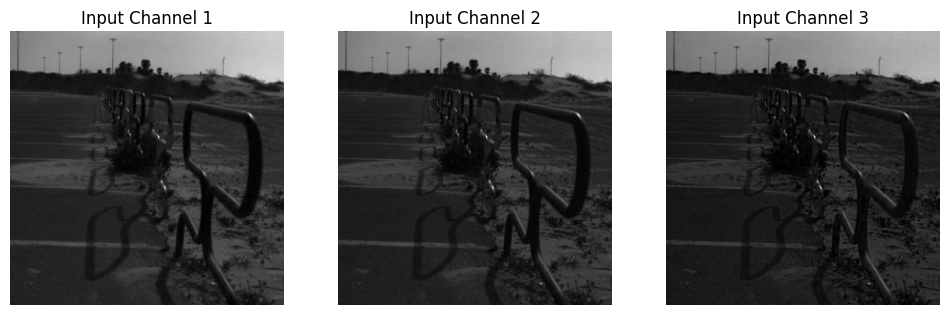

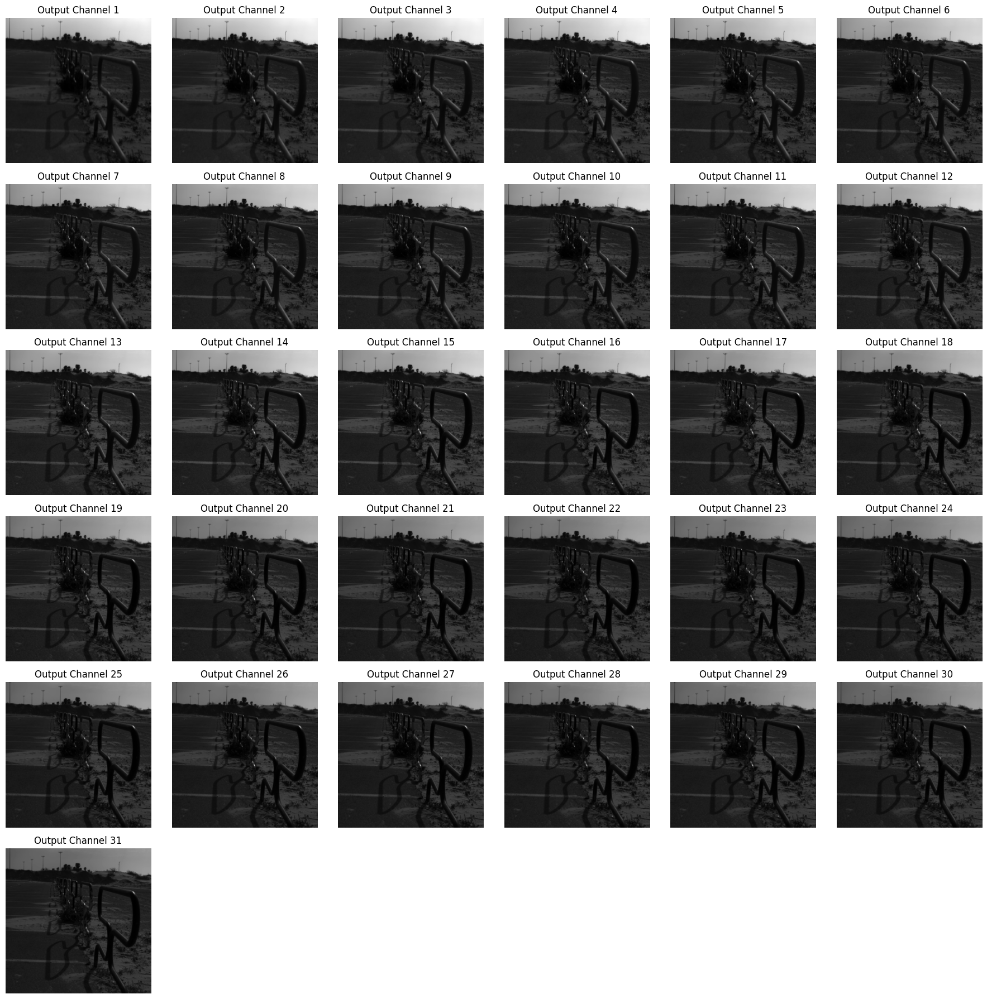

In [26]:
import matplotlib.pyplot as plt

sample = train_dataset[500]
# sample = valid_dataset[28]
x, y = sample[0], sample[1]

# Create subplots for the 3-channel input (RGB)
plt.figure(figsize=(12, 4))
for i in range(x.shape[0]):  # Loop through channels
    plt.subplot(1, 3, i + 1)  # Adjust for the number of input channels (3)
    channel_data = x[i]
    plt.imshow(channel_data, cmap='gray')  # Display each channel in grayscale
    plt.title(f'Input Channel {i + 1}')
    plt.axis('off')

# Create subplots for the 31-channel output (Hyperspectral)
plt.figure(figsize=(18, 18))  # Adjust size as needed
for i in range(y.shape[0]):  # Loop through channels
    plt.subplot(6, 6, i + 1)  # Adjust subplot grid for 31 channels
    channel_data = y[i]
    plt.imshow(channel_data, cmap='gray')  # Display each channel in grayscale
    plt.title(f'Output Channel {i + 1}')
    plt.axis('off')

plt.tight_layout()
plt.show()


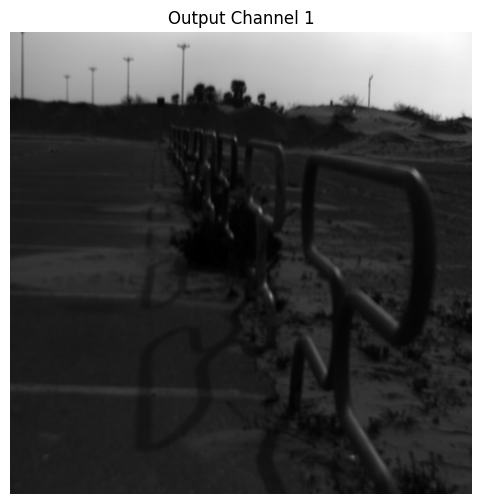

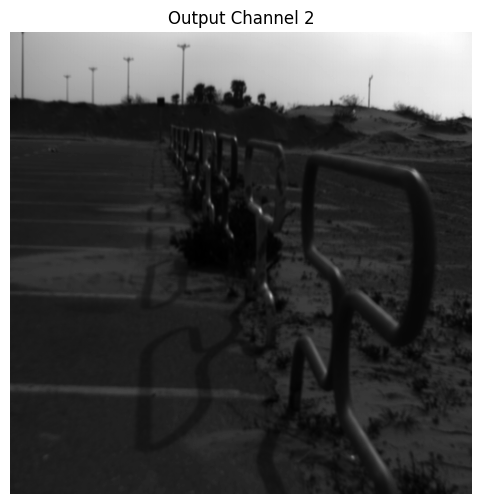

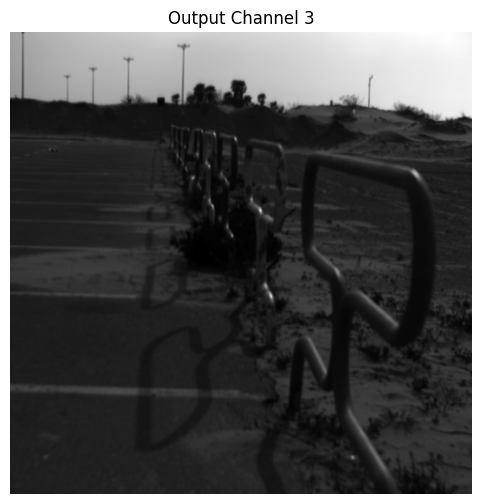

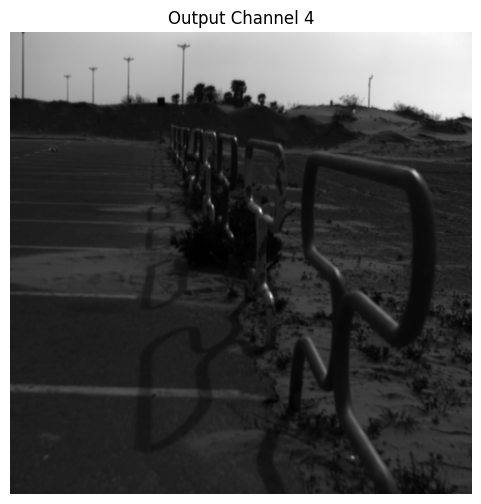

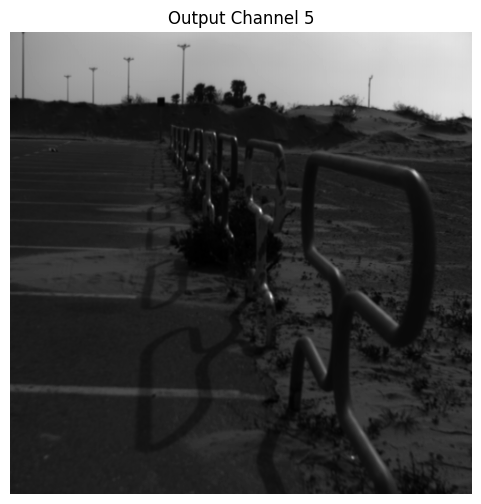

...

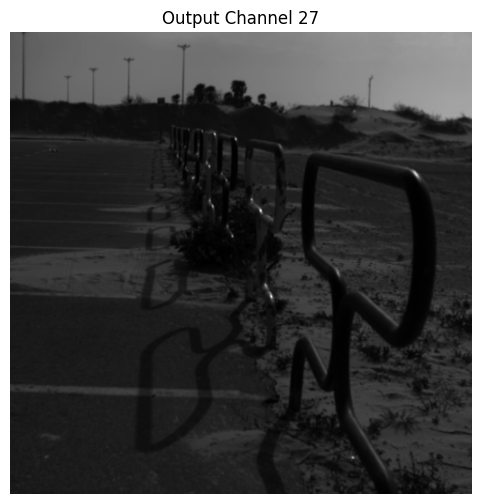

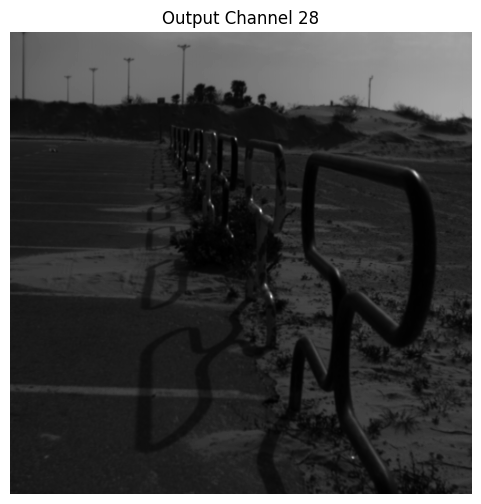

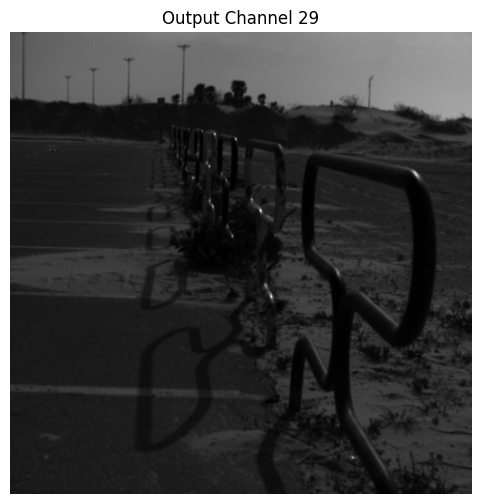

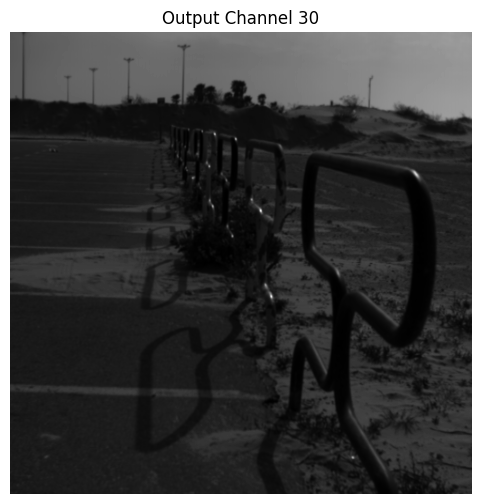

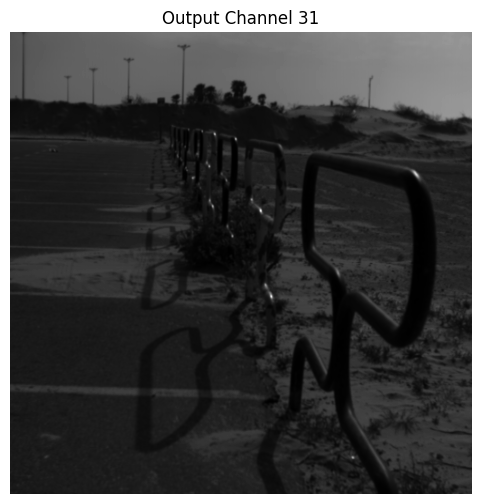

In [27]:
# Iterate through each channel in the output HSI
for i in range(y.shape[0]):
    plt.figure(figsize=(6, 6))  # Adjust the figure size as needed
    channel_data = y[i]
    
    # Display the channel data
    plt.imshow(channel_data, cmap='gray')
    plt.title(f'Output Channel {i + 1}')
    plt.axis('off')
    
    # Show the plot for the current channel
    plt.show()


## custom SAM LOSS

In [10]:
import torch
import torch.nn as nn

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class SAMLoss(nn.Module):
    def __init__(self):
        super(SAMLoss, self).__init__()

    def forward(self, predicted_hsi, ground_truth_hsi):
        # Ensure the input tensors have the same shape
        assert predicted_hsi.shape == ground_truth_hsi.shape, "Input tensor shapes must match."

        # Reshape tensors if necessary
        if predicted_hsi.dim() == 4:  # If the tensors are 4D, flatten them
            predicted_hsi = predicted_hsi.view(predicted_hsi.size(0), -1)
            ground_truth_hsi = ground_truth_hsi.view(ground_truth_hsi.size(0), -1)

        # Calculate the dot product and magnitudes
        dot_product = torch.sum(predicted_hsi * ground_truth_hsi, dim=1)
        magnitude_pred = torch.norm(predicted_hsi, dim=1)
        magnitude_gt = torch.norm(ground_truth_hsi, dim=1)

        # Calculate the cosine of the spectral angle
        cosine_theta = dot_product / (magnitude_pred * magnitude_gt)

        # Calculate the spectral angle in radians
        spectral_angle = torch.acos(cosine_theta)

        # Return the mean spectral angle as the loss
        return torch.mean(spectral_angle)

#  combined loss
import torch.nn as nn

class CombinedLoss(nn.Module):
    def __init__(self, alpha=0.5, beta=0.5):
        super(CombinedLoss, self).__init__()
        self.alpha = alpha
        self.beta = beta
        self.l1_loss = nn.L1Loss()
        self.sam_loss = SAMLoss()

    def forward(self, outputs, labels):
        loss_l1 = self.l1_loss(outputs, labels)
        loss_sam = self.sam_loss(outputs, labels)
        combined_loss = self.alpha * loss_l1 + self.beta * loss_sam
        return combined_loss


In [11]:
import torch
import torch.nn as nn
def default_conv(in_channels, out_channels, kernel_size, bias=True):
    return nn.Conv2d(
        in_channels, out_channels, kernel_size,
        padding=(kernel_size//2), bias=bias)

class MeanShift(nn.Conv2d):
    def __init__(self, rgb_range, rgb_mean, rgb_std, sign=-1):
        super(MeanShift, self).__init__(3, 3, kernel_size=1)
        std = torch.Tensor(rgb_std)
        self.weight.data = torch.eye(3).view(3, 3, 1, 1)
        self.weight.data.div_(std.view(3, 1, 1, 1))
        self.bias.data = sign * rgb_range * torch.Tensor(rgb_mean)
        self.bias.data.div_(std)
        self.requires_grad = False

class BasicBlock(nn.Sequential):
    def __init__(
        self, in_channels, out_channels, kernel_size, stride=1, bias=False,
        bn=True, act=nn.ReLU(True)):

        m = [nn.Conv2d(
            in_channels, out_channels, kernel_size,
            padding=(kernel_size//2), stride=stride, bias=bias)
        ]
        if bn: m.append(nn.BatchNorm2d(out_channels))
        if act is not None: m.append(act)
        super(BasicBlock, self).__init__(*m)

class ResBlock(nn.Module):
    def __init__(
        self, conv=default_conv, n_feat=31, kernel_size=3,
        bias=True, bn=False, act=nn.ReLU(True), res_scale=1):

        super(ResBlock, self).__init__()
        m = []
        for i in range(2):
            m.append(conv(n_feat, n_feat, kernel_size, bias=bias))
            if bn: m.append(nn.BatchNorm2d(n_feat))
            if i == 0: m.append(act)

        self.body = nn.Sequential(*m)
        self.res_scale = res_scale

    def forward(self, x):
        res = self.body(x).mul(self.res_scale)
        res += x

        return res

class Upsampler(nn.Sequential):
    def __init__(self, conv, scale, n_feat, bn=False, act=False, bias=True):

        m = []
        if (scale & (scale - 1)) == 0:    # Is scale = 2^n?
            for _ in range(int(math.log(scale, 2))):
                m.append(conv(n_feat, 4 * n_feat, 3, bias))
                m.append(nn.PixelShuffle(2))
                if bn: m.append(nn.BatchNorm2d(n_feat))
                if act: m.append(act())
        elif scale == 3:
            m.append(conv(n_feat, 9 * n_feat, 3, bias))
            m.append(nn.PixelShuffle(3))
            if bn: m.append(nn.BatchNorm2d(n_feat))
            if act: m.append(act())
        else:
            raise NotImplementedError

        super(Upsampler, self).__init__(*m)

## add SELayer
class SELayer(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SELayer, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.conv_du = nn.Sequential(
                nn.Conv2d(channel, channel // reduction, 1, padding=0, bias=True),
                nn.ReLU(inplace=True),
                nn.Conv2d(channel // reduction, channel, 1, padding=0, bias=True),
                nn.Sigmoid()
        )

    def forward(self, x):
        y = self.avg_pool(x)
        y = self.conv_du(y)
        return x * y

## add SEResBlock
class SEResBlock(nn.Module):
    def __init__(
        self, conv, n_feat, kernel_size, reduction,
        bias=True, bn=False, act=nn.ReLU(True), res_scale=1):

        super(SEResBlock, self).__init__()
        modules_body = []
        for i in range(2):
            modules_body.append(conv(n_feat, n_feat, kernel_size, bias=bias))
            if bn: modules_body.append(nn.BatchNorm2d(n_feat))
            if i == 0: modules_body.append(act)
        modules_body.append(SELayer(n_feat, reduction))
        self.body = nn.Sequential(*modules_body)
        self.res_scale = res_scale

    def forward(self, x):
        res = self.body(x)
        #res = self.body(x).mul(self.res_scale)
        res += x

        return res


_NORM_BONE = False

def constant_init(module, val, bias=0):
    if hasattr(module, 'weight') and module.weight is not None:
        nn.init.constant_(module.weight, val)
    if hasattr(module, 'bias') and module.bias is not None:
        nn.init.constant_(module.bias, bias)


def kaiming_init(module,
                 a=0,
                 mode='fan_out',
                 nonlinearity='relu',
                 bias=0,
                 distribution='normal'):
    assert distribution in ['uniform', 'normal']
    if distribution == 'uniform':
        nn.init.kaiming_uniform_(
            module.weight, a=a, mode=mode, nonlinearity=nonlinearity)
    else:
        nn.init.kaiming_normal_(
            module.weight, a=a, mode=mode, nonlinearity=nonlinearity)
    if hasattr(module, 'bias') and module.bias is not None:
        nn.init.constant_(module.bias, bias)

# depthwise-separable convolution (DSC)
class DSC(nn.Module):

    def __init__(self, nin: int) -> None:
        super(DSC, self).__init__()
        self.conv_dws = nn.Conv2d(
            nin, nin, kernel_size=1, stride=1, padding=0, groups=nin
        )
        self.bn_dws = nn.BatchNorm2d(nin, momentum=0.9)
        self.relu_dws = nn.ReLU(inplace=False)

        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=1, padding=1)

        self.conv_point = nn.Conv2d(
            nin, 1, kernel_size=1, stride=1, padding=0, groups=1
        )
        self.bn_point = nn.BatchNorm2d(1, momentum=0.9)
        self.relu_point = nn.ReLU(inplace=False)

        self.softmax = nn.Softmax(dim=2)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        out = self.conv_dws(x)
        out = self.bn_dws(out)
        out = self.relu_dws(out)

        out = self.maxpool(out)

        out = self.conv_point(out)
        out = self.bn_point(out)
        out = self.relu_point(out)

        m, n, p, q = out.shape
        out = self.softmax(out.view(m, n, -1))
        out = out.view(m, n, p, q)

        out = out.expand(x.shape[0], x.shape[1], x.shape[2], x.shape[3])

        out = torch.mul(out, x)

        out = out + x

        return out

# Efficient Feature Fusion(EFF)
class EFF(nn.Module):
    def __init__(self, nin: int, nout: int, num_splits: int) -> None:
        super(EFF, self).__init__()

        assert nin % num_splits == 0

        self.nin = nin
        self.nout = nout
        self.num_splits = num_splits
        self.subspaces = nn.ModuleList(
            [DSC(int(self.nin / self.num_splits)) for i in range(self.num_splits)]
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        sub_feat = torch.chunk(x, self.num_splits, dim=1)
        out = []
        for idx, l in enumerate(self.subspaces):
            out.append(self.subspaces[idx](sub_feat[idx]))
        out = torch.cat(out, dim=1)

        return out


# spatial-spectral domain attention learning(SDL)
class SDL_attention(nn.Module):
    def __init__(self, inplanes, planes, kernel_size=1, stride=1):
        super(SDL_attention, self).__init__()

        self.inplanes = inplanes
        self.inter_planes = planes // 2
        self.planes = planes
        self.kernel_size = kernel_size
        self.stride = stride
        self.padding = (kernel_size-1)//2

        self.conv_q_right = nn.Conv2d(self.inplanes, 1, kernel_size=1, stride=stride, padding=0, bias=False)
        self.conv_v_right = nn.Conv2d(self.inplanes, self.inter_planes, kernel_size=1, stride=stride, padding=0, bias=False)
        self.conv_up = nn.Conv2d(self.inter_planes, self.planes, kernel_size=1, stride=1, padding=0, bias=False)
        self.softmax_right = nn.Softmax(dim=2)
        self.sigmoid = nn.Sigmoid()

        self.conv_q_left = nn.Conv2d(self.inplanes, self.inter_planes, kernel_size=1, stride=stride, padding=0, bias=False)   #g
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.conv_v_left = nn.Conv2d(self.inplanes, self.inter_planes, kernel_size=1, stride=stride, padding=0, bias=False)   #theta
        self.softmax_left = nn.Softmax(dim=2)

        self.reset_parameters()

    def reset_parameters(self):
        kaiming_init(self.conv_q_right, mode='fan_in')
        kaiming_init(self.conv_v_right, mode='fan_in')
        kaiming_init(self.conv_q_left, mode='fan_in')
        kaiming_init(self.conv_v_left, mode='fan_in')

        self.conv_q_right.inited = True
        self.conv_v_right.inited = True
        self.conv_q_left.inited = True
        self.conv_v_left.inited = True
    # HR spatial attention
    def spatial_attention(self, x):
        input_x = self.conv_v_right(x)
        batch, channel, height, width = input_x.size()

        input_x = input_x.view(batch, channel, height * width)
        context_mask = self.conv_q_right(x)
        context_mask = context_mask.view(batch, 1, height * width)
        context_mask = self.softmax_right(context_mask)

        context = torch.matmul(input_x, context_mask.transpose(1,2))
        context = context.unsqueeze(-1)
        context = self.conv_up(context)

        mask_ch = self.sigmoid(context)

        out = x * mask_ch

        return out
    # HR spectral attention
    def spectral_attention(self, x):

        g_x = self.conv_q_left(x)
        batch, channel, height, width = g_x.size()

        avg_x = self.avg_pool(g_x)
        batch, channel, avg_x_h, avg_x_w = avg_x.size()

        avg_x = avg_x.view(batch, channel, avg_x_h * avg_x_w).permute(0, 2, 1)
        theta_x = self.conv_v_left(x).view(batch, self.inter_planes, height * width)
        context = torch.matmul(avg_x, theta_x)
        context = self.softmax_left(context)
        context = context.view(batch, 1, height, width)

        mask_sp = self.sigmoid(context)

        out = x * mask_sp

        return out

    def forward(self, x):
        context_spectral = self.spectral_attention(x)
        context_spatial = self.spatial_attention(x)
        out = context_spatial + context_spectral
        return out


class HDNet(nn.Module):

    def __init__(self, in_ch=3, out_ch=31, conv=default_conv):
        super(HDNet, self).__init__()

        n_resblocks = 32
        n_feats = 48
        kernel_size = 3
        act = nn.ReLU(True)

        # define head module
        m_head = [conv(in_ch, n_feats, kernel_size)]

        # define body module
        m_body = [
            ResBlock(
                conv, n_feats, kernel_size, act=act, res_scale= 1
            ) for _ in range(n_resblocks)
        ]
        m_body.append(SDL_attention(inplanes = n_feats, planes = n_feats))
        m_body.append(EFF(nin=n_feats, nout=n_feats, num_splits=4))

        for i in range(1, n_resblocks):
            m_body.append(ResBlock(
                conv, n_feats, kernel_size, act=act, res_scale= 1
            ))

        m_body.append(conv(n_feats, n_feats, kernel_size))

        m_tail = [conv(n_feats, out_ch, kernel_size)]

        self.head = nn.Sequential(*m_head)
        self.body = nn.Sequential(*m_body)
        self.tail = nn.Sequential(*m_tail)

    def forward(self, x):
        x = self.head(x)

        res = self.body(x)
        res += x

        x = self.tail(res)

        return x

# frequency domain learning(FDL)
class FDL(nn.Module):
    def __init__(self, loss_weight=1.0, alpha=1.0, patch_factor=1, ave_spectrum=False, log_matrix=False, batch_matrix=False):
        super(FDL, self).__init__()
        self.loss_weight = loss_weight
        self.alpha = alpha
        self.patch_factor = patch_factor
        self.ave_spectrum = ave_spectrum
        self.log_matrix = log_matrix
        self.batch_matrix = batch_matrix

    def tensor2freq(self, x):
        patch_factor = self.patch_factor
        _, _, h, w = x.shape
        assert h % patch_factor == 0 and w % patch_factor == 0, (
            'Patch factor should be divisible by image height and width')
        patch_list = []
        patch_h = h // patch_factor
        patch_w = w // patch_factor
        for i in range(patch_factor):
            for j in range(patch_factor):
                patch_list.append(x[:, :, i * patch_h:(i + 1) * patch_h, j * patch_w:(j + 1) * patch_w])

        y = torch.stack(patch_list, 1)

        return torch.rfft(y, 2, onesided=False, normalized=True)

    def loss_formulation(self, recon_freq, real_freq, matrix=None):
        if matrix is not None:
            weight_matrix = matrix.detach()
        else:
            matrix_tmp = (recon_freq - real_freq) ** 2
            matrix_tmp = torch.sqrt(matrix_tmp[..., 0] + matrix_tmp[..., 1]) ** self.alpha
            if self.log_matrix:
                matrix_tmp = torch.log(matrix_tmp + 1.0)

            if self.batch_matrix:
                matrix_tmp = matrix_tmp / matrix_tmp.max()
            else:
                matrix_tmp = matrix_tmp / matrix_tmp.max(-1).values.max(-1).values[:, :, :, None, None]

            matrix_tmp[torch.isnan(matrix_tmp)] = 0.0
            matrix_tmp = torch.clamp(matrix_tmp, min=0.0, max=1.0)
            weight_matrix = matrix_tmp.clone().detach()

        assert weight_matrix.min().item() >= 0 and weight_matrix.max().item() <= 1, (
            'The values of spectrum weight matrix should be in the range [0, 1], '
            'but got Min: %.10f Max: %.10f' % (weight_matrix.min().item(), weight_matrix.max().item()))

        tmp = (recon_freq - real_freq) ** 2
        freq_distance = tmp[..., 0] + tmp[..., 1]

        loss = weight_matrix * freq_distance
        return torch.mean(loss)

    def forward(self, pred, target, matrix=None, **kwargs):

        pred_freq = self.tensor2freq(pred)
        target_freq = self.tensor2freq(target)

        if self.ave_spectrum:
            pred_freq = torch.mean(pred_freq, 0, keepdim=True)
            target_freq = torch.mean(target_freq, 0, keepdim=True)

        return self.loss_formulation(pred_freq, target_freq, matrix) * self.loss_weight


In [11]:
model = HDNet().cuda()
model.load_state_dict(torch.load('../Models/model_zoo/hdnet/hdnet.pth', map_location=device))
model.eval()

RuntimeError: Error(s) in loading state_dict for HDNet:
	Missing key(s) in state_dict: "body.16.body.0.weight", "body.16.body.0.bias", "body.16.body.2.weight", "body.16.body.2.bias", "body.17.body.0.weight", "body.17.body.0.bias", "body.17.body.2.weight", "body.17.body.2.bias", "body.32.conv_q_right.weight", "body.32.conv_v_right.weight", "body.32.conv_up.weight", "body.32.conv_q_left.weight", "body.32.conv_v_left.weight", "body.33.subspaces.0.conv_dws.weight", "body.33.subspaces.0.conv_dws.bias", "body.33.subspaces.0.bn_dws.weight", "body.33.subspaces.0.bn_dws.bias", "body.33.subspaces.0.bn_dws.running_mean", "body.33.subspaces.0.bn_dws.running_var", "body.33.subspaces.0.conv_point.weight", "body.33.subspaces.0.conv_point.bias", "body.33.subspaces.0.bn_point.weight", "body.33.subspaces.0.bn_point.bias", "body.33.subspaces.0.bn_point.running_mean", "body.33.subspaces.0.bn_point.running_var", "body.33.subspaces.1.conv_dws.weight", "body.33.subspaces.1.conv_dws.bias", "body.33.subspaces.1.bn_dws.weight", "body.33.subspaces.1.bn_dws.bias", "body.33.subspaces.1.bn_dws.running_mean", "body.33.subspaces.1.bn_dws.running_var", "body.33.subspaces.1.conv_point.weight", "body.33.subspaces.1.conv_point.bias", "body.33.subspaces.1.bn_point.weight", "body.33.subspaces.1.bn_point.bias", "body.33.subspaces.1.bn_point.running_mean", "body.33.subspaces.1.bn_point.running_var", "body.33.subspaces.2.conv_dws.weight", "body.33.subspaces.2.conv_dws.bias", "body.33.subspaces.2.bn_dws.weight", "body.33.subspaces.2.bn_dws.bias", "body.33.subspaces.2.bn_dws.running_mean", "body.33.subspaces.2.bn_dws.running_var", "body.33.subspaces.2.conv_point.weight", "body.33.subspaces.2.conv_point.bias", "body.33.subspaces.2.bn_point.weight", "body.33.subspaces.2.bn_point.bias", "body.33.subspaces.2.bn_point.running_mean", "body.33.subspaces.2.bn_point.running_var", "body.33.subspaces.3.conv_dws.weight", "body.33.subspaces.3.conv_dws.bias", "body.33.subspaces.3.bn_dws.weight", "body.33.subspaces.3.bn_dws.bias", "body.33.subspaces.3.bn_dws.running_mean", "body.33.subspaces.3.bn_dws.running_var", "body.33.subspaces.3.conv_point.weight", "body.33.subspaces.3.conv_point.bias", "body.33.subspaces.3.bn_point.weight", "body.33.subspaces.3.bn_point.bias", "body.33.subspaces.3.bn_point.running_mean", "body.33.subspaces.3.bn_point.running_var", "body.34.body.0.weight", "body.34.body.0.bias", "body.34.body.2.weight", "body.34.body.2.bias", "body.35.body.0.weight", "body.35.body.0.bias", "body.35.body.2.weight", "body.35.body.2.bias", "body.36.body.0.weight", "body.36.body.0.bias", "body.36.body.2.weight", "body.36.body.2.bias", "body.37.body.0.weight", "body.37.body.0.bias", "body.37.body.2.weight", "body.37.body.2.bias", "body.38.body.0.weight", "body.38.body.0.bias", "body.38.body.2.weight", "body.38.body.2.bias", "body.39.body.0.weight", "body.39.body.0.bias", "body.39.body.2.weight", "body.39.body.2.bias", "body.40.body.0.weight", "body.40.body.0.bias", "body.40.body.2.weight", "body.40.body.2.bias", "body.41.body.0.weight", "body.41.body.0.bias", "body.41.body.2.weight", "body.41.body.2.bias", "body.42.body.0.weight", "body.42.body.0.bias", "body.42.body.2.weight", "body.42.body.2.bias", "body.43.body.0.weight", "body.43.body.0.bias", "body.43.body.2.weight", "body.43.body.2.bias", "body.44.body.0.weight", "body.44.body.0.bias", "body.44.body.2.weight", "body.44.body.2.bias", "body.45.body.0.weight", "body.45.body.0.bias", "body.45.body.2.weight", "body.45.body.2.bias", "body.46.body.0.weight", "body.46.body.0.bias", "body.46.body.2.weight", "body.46.body.2.bias", "body.47.body.0.weight", "body.47.body.0.bias", "body.47.body.2.weight", "body.47.body.2.bias", "body.48.body.0.weight", "body.48.body.0.bias", "body.48.body.2.weight", "body.48.body.2.bias", "body.49.body.0.weight", "body.49.body.0.bias", "body.49.body.2.weight", "body.49.body.2.bias", "body.50.body.0.weight", "body.50.body.0.bias", "body.50.body.2.weight", "body.50.body.2.bias", "body.51.body.0.weight", "body.51.body.0.bias", "body.51.body.2.weight", "body.51.body.2.bias", "body.52.body.0.weight", "body.52.body.0.bias", "body.52.body.2.weight", "body.52.body.2.bias", "body.53.body.0.weight", "body.53.body.0.bias", "body.53.body.2.weight", "body.53.body.2.bias", "body.54.body.0.weight", "body.54.body.0.bias", "body.54.body.2.weight", "body.54.body.2.bias", "body.55.body.0.weight", "body.55.body.0.bias", "body.55.body.2.weight", "body.55.body.2.bias", "body.56.body.0.weight", "body.56.body.0.bias", "body.56.body.2.weight", "body.56.body.2.bias", "body.57.body.0.weight", "body.57.body.0.bias", "body.57.body.2.weight", "body.57.body.2.bias", "body.58.body.0.weight", "body.58.body.0.bias", "body.58.body.2.weight", "body.58.body.2.bias", "body.59.body.0.weight", "body.59.body.0.bias", "body.59.body.2.weight", "body.59.body.2.bias", "body.60.body.0.weight", "body.60.body.0.bias", "body.60.body.2.weight", "body.60.body.2.bias", "body.61.body.0.weight", "body.61.body.0.bias", "body.61.body.2.weight", "body.61.body.2.bias", "body.62.body.0.weight", "body.62.body.0.bias", "body.62.body.2.weight", "body.62.body.2.bias", "body.63.body.0.weight", "body.63.body.0.bias", "body.63.body.2.weight", "body.63.body.2.bias", "body.64.body.0.weight", "body.64.body.0.bias", "body.64.body.2.weight", "body.64.body.2.bias", "body.65.weight", "body.65.bias". 
	Unexpected key(s) in state_dict: "body.16.conv_q_right.weight", "body.16.conv_v_right.weight", "body.16.conv_up.weight", "body.16.conv_q_left.weight", "body.16.conv_v_left.weight", "body.17.subspaces.0.conv_dws.weight", "body.17.subspaces.0.conv_dws.bias", "body.17.subspaces.0.bn_dws.weight", "body.17.subspaces.0.bn_dws.bias", "body.17.subspaces.0.bn_dws.running_mean", "body.17.subspaces.0.bn_dws.running_var", "body.17.subspaces.0.bn_dws.num_batches_tracked", "body.17.subspaces.0.conv_point.weight", "body.17.subspaces.0.conv_point.bias", "body.17.subspaces.0.bn_point.weight", "body.17.subspaces.0.bn_point.bias", "body.17.subspaces.0.bn_point.running_mean", "body.17.subspaces.0.bn_point.running_var", "body.17.subspaces.0.bn_point.num_batches_tracked", "body.17.subspaces.1.conv_dws.weight", "body.17.subspaces.1.conv_dws.bias", "body.17.subspaces.1.bn_dws.weight", "body.17.subspaces.1.bn_dws.bias", "body.17.subspaces.1.bn_dws.running_mean", "body.17.subspaces.1.bn_dws.running_var", "body.17.subspaces.1.bn_dws.num_batches_tracked", "body.17.subspaces.1.conv_point.weight", "body.17.subspaces.1.conv_point.bias", "body.17.subspaces.1.bn_point.weight", "body.17.subspaces.1.bn_point.bias", "body.17.subspaces.1.bn_point.running_mean", "body.17.subspaces.1.bn_point.running_var", "body.17.subspaces.1.bn_point.num_batches_tracked", "body.17.subspaces.2.conv_dws.weight", "body.17.subspaces.2.conv_dws.bias", "body.17.subspaces.2.bn_dws.weight", "body.17.subspaces.2.bn_dws.bias", "body.17.subspaces.2.bn_dws.running_mean", "body.17.subspaces.2.bn_dws.running_var", "body.17.subspaces.2.bn_dws.num_batches_tracked", "body.17.subspaces.2.conv_point.weight", "body.17.subspaces.2.conv_point.bias", "body.17.subspaces.2.bn_point.weight", "body.17.subspaces.2.bn_point.bias", "body.17.subspaces.2.bn_point.running_mean", "body.17.subspaces.2.bn_point.running_var", "body.17.subspaces.2.bn_point.num_batches_tracked", "body.17.subspaces.3.conv_dws.weight", "body.17.subspaces.3.conv_dws.bias", "body.17.subspaces.3.bn_dws.weight", "body.17.subspaces.3.bn_dws.bias", "body.17.subspaces.3.bn_dws.running_mean", "body.17.subspaces.3.bn_dws.running_var", "body.17.subspaces.3.bn_dws.num_batches_tracked", "body.17.subspaces.3.conv_point.weight", "body.17.subspaces.3.conv_point.bias", "body.17.subspaces.3.bn_point.weight", "body.17.subspaces.3.bn_point.bias", "body.17.subspaces.3.bn_point.running_mean", "body.17.subspaces.3.bn_point.running_var", "body.17.subspaces.3.bn_point.num_batches_tracked", "body.32.body.0.weight", "body.32.body.0.bias", "body.32.body.2.weight", "body.32.body.2.bias", "body.33.weight", "body.33.bias". 
	size mismatch for head.0.weight: copying a param with shape torch.Size([64, 28, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 3, 3, 3]).
	size mismatch for head.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.0.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.0.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.0.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.0.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.1.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.1.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.1.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.1.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.2.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.2.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.2.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.2.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.3.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.3.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.3.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.3.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.4.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.4.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.4.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.4.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.5.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.5.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.5.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.5.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.6.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.6.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.6.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.6.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.7.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.7.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.7.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.7.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.8.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.8.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.8.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.8.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.9.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.9.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.9.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.9.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.10.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.10.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.10.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.10.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.11.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.11.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.11.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.11.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.12.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.12.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.12.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.12.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.13.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.13.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.13.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.13.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.14.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.14.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.14.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.14.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.15.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.15.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.15.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.15.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.18.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.18.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.18.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.18.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.19.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.19.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.19.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.19.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.20.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.20.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.20.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.20.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.21.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.21.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.21.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.21.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.22.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.22.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.22.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.22.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.23.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.23.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.23.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.23.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.24.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.24.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.24.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.24.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.25.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.25.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.25.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.25.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.26.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.26.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.26.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.26.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.27.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.27.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.27.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.27.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.28.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.28.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.28.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.28.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.29.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.29.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.29.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.29.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.30.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.30.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.30.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.30.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.31.body.0.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.31.body.0.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for body.31.body.2.weight: copying a param with shape torch.Size([64, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([48, 48, 3, 3]).
	size mismatch for body.31.body.2.bias: copying a param with shape torch.Size([64]) from checkpoint, the shape in current model is torch.Size([48]).
	size mismatch for tail.0.weight: copying a param with shape torch.Size([28, 64, 3, 3]) from checkpoint, the shape in current model is torch.Size([31, 48, 3, 3]).
	size mismatch for tail.0.bias: copying a param with shape torch.Size([28]) from checkpoint, the shape in current model is torch.Size([31]).

## load the trained model

In [83]:
# from Models_code.FocusNet_norm import FocusNet
# from Models_code.inverseUNet import UNet
from Models_code.HyperAttention_fft_norm_2 import HyperAttention
# from Models_code.Dwt_ntire import MWCNN
# from Models_code.FocusNet_averagepool import FocusNet
# from Models_code.Simple_UNet import Simple_UNet
# from Models_code.MST import MST


# model = MST(dim=31, stage=2, num_blocks=[4, 7, 5]).cuda()
model = HyperAttention(in_channels=3, out_channels=31).to(device).float()
# model = FocusNet(in_channels=3, out_channels=31).to(device).float()
# model = UNet(in_channels=3, out_channels=31).to(device).float()
# model = Simple_UNet(in_channels=3, out_channels=31).to(device).float()
# model = MWCNN().to(device).float()


# model.load_state_dict(torch.load('../Models/FocusNet_norm_averagepool_1000e.pth', map_location=device))
# model.load_state_dict(torch.load('../Hyper_Skin/Models/best_HyperAttention_fft_rgb.pth', map_location=device))
model.eval() 

HyperAttention(
  (enc1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (enc2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (en2_spatial_att): SpatialAttention(
    (conv1): Conv2d(128, 1, kernel_size=(1, 1), stride=(1, 1))
    (sigmoid): Sigmoid()
    (batch_norm): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (enc3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace

## flops and params

In [84]:
import torch
from fvcore.nn import FlopCountAnalysis

def calculate_flops(model, input_size=(1, 3, 256, 256)):
    inputs = torch.randn(input_size).to(device)  # Ensure input is on the same device
    flops = FlopCountAnalysis(model, inputs)
    total_flops = flops.total()
    return total_flops

# Example usage

flops = calculate_flops(model, input_size=(1, 3, 256, 256)) # Adjust the input size according to your model's requirements
n_param = sum([p.nelement() for p in model.parameters()])
print(f'GMac:{flops/(1024*1024*1024)}')
print(f'Params:{n_param}')


Unsupported operator aten::max_pool2d encountered 3 time(s)
Unsupported operator aten::sigmoid encountered 2 time(s)
Unsupported operator aten::mul encountered 4 time(s)
Unsupported operator aten::fft_fft2 encountered 2 time(s)
Unsupported operator aten::abs encountered 1 time(s)
Unsupported operator aten::angle encountered 1 time(s)
Unsupported operator aten::exp encountered 1 time(s)
Unsupported operator aten::fft_ifft2 encountered 1 time(s)
Unsupported operator aten::real encountered 1 time(s)
Unsupported operator aten::add encountered 3 time(s)
Unsupported operator aten::avg_pool2d encountered 1 time(s)
Unsupported operator aten::min encountered 1 time(s)
Unsupported operator aten::sub encountered 2 time(s)
Unsupported operator aten::div encountered 1 time(s)


GMac:12.72802746295929
Params:4333921


In [85]:
# # from Models_code.Ensemble_FocusNet_multibranch import EnsembleModel, MultiBranchModel , FocusNet
# from Models_code.Ensemble_haf_3 import EnsembleModel, HyperAttention , SecondModel
# # from Models_code.Ensemble_FocusNet_HyperAttention import EnsembleModel, HyperAttention , FocusNet
    
# # focusnet_model = FocusNet(in_channels=3, out_channels=31).to(device).float()  # Adjust out_channels to match the target label size
# # first_model = FocusNet(in_channels=3, out_channels=31).to(device).float()
# first_model = HyperAttention(in_channels=3, out_channels=31).to(device).float()
# # Initialize the second model
# # second_model = MultiBranchModel().to(device).float()
# second_model = SecondModel().to(device).float()
# # second_model = HyperAttention(in_channels=34, out_channels=31).to(device).float()

# # Create the ensemble model
# model = EnsembleModel(first_model, second_model).to(device).float()

# model.load_state_dict(torch.load('../Models/best_Ensemble_haf_3.0.pth', map_location=device))
# model.eval() 

## predict on a single file with the model

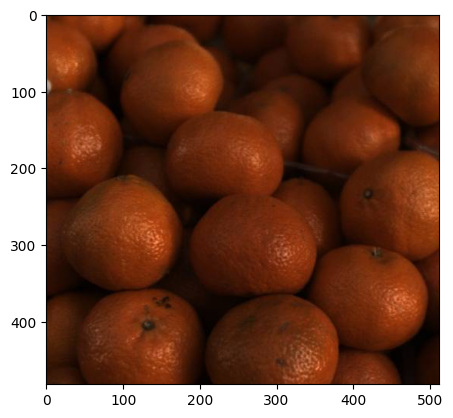

In [13]:
# image_path = "C:/Users/user/Desktop/HSI/dataset/ICASSP2024-SPGC/Hyper-Skin(RGB,VIS)/test/RGB_CIE/p012_neutral_front.jpg"
# image_path = 'C:/Users/user/Desktop/Research/NTIRE_2022/NTIRE_2022/Test_RGB/ARAD_1K_0951.jpg'
# image_path = 'C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_RGB/ARAD_1K_0929.jpg'
image_path = 'C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Train_RGB/ARAD_1K_0165.jpg'
# image_path = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Train_RGB/ARAD_1K_0194.jpg"
image = Image.open(image_path)
plt.imshow(image)

In [14]:
image.size

(512, 482)

In [15]:
# Define transformations to convert and preprocess the image
preprocess = transforms.Compose([
    transforms.Resize((512, 512)),  # Resize the image to match your model's input size
    transforms.ToTensor(),  # Convert the image to a PyTorch tensor
])

# Apply the transformations to the image
input_data = preprocess(image)

# Add an extra dimension to match the batch size (1 image in this case)
input_data = input_data.unsqueeze(0)

with torch.no_grad():
    input_data = input_data.to(device)
    output = model(input_data)
    
print('input data max',input_data.max())
print('input data min',input_data.min())
print(output.shape)
print('output max',output.max())
print('output min',output.min())

input data max tensor(1., device='cuda:0')
input data min tensor(0., device='cuda:0')
torch.Size([1, 31, 512, 512])
output max tensor(1., device='cuda:0')
output min tensor(0., device='cuda:0')


In [16]:
output

tensor([[[[0.0290, 0.0221, 0.0197,  ..., 0.0268, 0.0279, 0.0226],
          [0.0220, 0.0180, 0.0192,  ..., 0.0239, 0.0208, 0.0219],
          [0.0270, 0.0240, 0.0208,  ..., 0.0279, 0.0258, 0.0237],
          ...,
          [0.0152, 0.0146, 0.0115,  ..., 0.0055, 0.0043, 0.0051],
          [0.0171, 0.0170, 0.0200,  ..., 0.0087, 0.0117, 0.0087],
          [0.0197, 0.0200, 0.0197,  ..., 0.0074, 0.0090, 0.0094]],

         [[0.0297, 0.0251, 0.0193,  ..., 0.0342, 0.0270, 0.0264],
          [0.0256, 0.0204, 0.0202,  ..., 0.0304, 0.0242, 0.0256],
          [0.0277, 0.0254, 0.0183,  ..., 0.0320, 0.0251, 0.0252],
          ...,
          [0.0191, 0.0181, 0.0142,  ..., 0.0069, 0.0034, 0.0045],
          [0.0178, 0.0186, 0.0209,  ..., 0.0093, 0.0088, 0.0096],
          [0.0235, 0.0236, 0.0234,  ..., 0.0078, 0.0101, 0.0108]],

         [[0.0325, 0.0278, 0.0228,  ..., 0.0370, 0.0305, 0.0294],
          [0.0290, 0.0231, 0.0240,  ..., 0.0322, 0.0268, 0.0284],
          [0.0289, 0.0265, 0.0216,  ..., 0

In [65]:
print(output[1])

IndexError: index 1 is out of bounds for dimension 0 with size 1

In [53]:
torch.set_printoptions(edgeitems=50, linewidth=200)

# Print the entire tensor
print(output[1])

IndexError: index 1 is out of bounds for dimension 0 with size 1

In [54]:
temp = output[1]

IndexError: index 1 is out of bounds for dimension 0 with size 1

In [42]:
temp.int()

tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,  ..., 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,  ..., 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,  ..., 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0, 0

In [43]:
tensor_rounded = torch.round(temp * 1000) / 1000

print(tensor_rounded)

tensor([[0.0260, 0.0250, 0.0270, 0.0270, 0.0140, 0.0120, 0.0120, 0.0120, 0.0090, 0.0070, 0.0090, 0.0070, 0.0110, 0.0110, 0.0080, 0.0090, 0.0110, 0.0110, 0.0100, 0.0100, 0.0140, 0.0140, 0.0110, 0.0120,
         0.0120, 0.0120, 0.0120, 0.0130, 0.0170, 0.0170, 0.0140, 0.0160, 0.0200, 0.0190, 0.0180, 0.0190, 0.0250, 0.0240, 0.0210, 0.0220, 0.0250, 0.0240, 0.0240, 0.0240, 0.0280, 0.0270, 0.0260, 0.0260,
         0.0300, 0.0300,  ..., 0.0190, 0.0190, 0.0210, 0.0200, 0.0210, 0.0220, 0.0240, 0.0230, 0.0210, 0.0210, 0.0220, 0.0200, 0.0210, 0.0210, 0.0240, 0.0220, 0.0210, 0.0210, 0.0240, 0.0220, 0.0220,
         0.0220, 0.0230, 0.0210, 0.0200, 0.0200, 0.0220, 0.0210, 0.0210, 0.0210, 0.0240, 0.0220, 0.0220, 0.0220, 0.0230, 0.0220, 0.0230, 0.0240, 0.0300, 0.0290, 0.0280, 0.0280, 0.0290, 0.0290, 0.0260,
         0.0260, 0.0400, 0.0400, 0.0360, 0.0370],
        [0.0240, 0.0210, 0.0250, 0.0210, 0.0110, 0.0090, 0.0100, 0.0090, 0.0090, 0.0060, 0.0090, 0.0070, 0.0100, 0.0110, 0.0080, 0.0090, 0.0110, 0.0

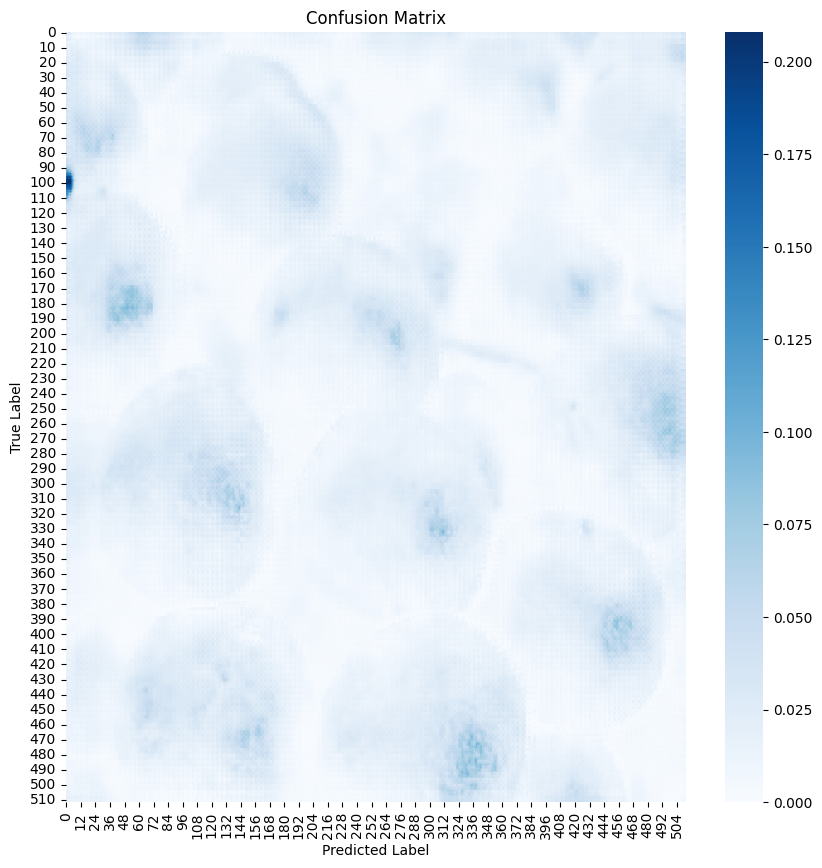

In [46]:
import matplotlib.pyplot as plt
import seaborn as sns
import torch

# Example tensor (replace this with your tensor)
tensor = torch.rand(512, 512)  # Replace this with your 512x512 tensor

# Convert tensor to numpy for plotting
conf_matrix = tensor_rounded.cpu().numpy()

# Plotting the confusion matrix
plt.figure(figsize=(10, 10))
sns.heatmap(conf_matrix, annot=False, cmap='Blues')
plt.title('Confusion Matrix')
plt.ylabel('True Label')
plt.xlabel('Predicted Label')
plt.show()


In [25]:
# Check if there are any NaN values in the output
nan_check = torch.isnan(output)
has_nan = torch.any(nan_check)

print("Does the output contain NaN values?", has_nan.item())


Does the output contain NaN values? False


## visualize

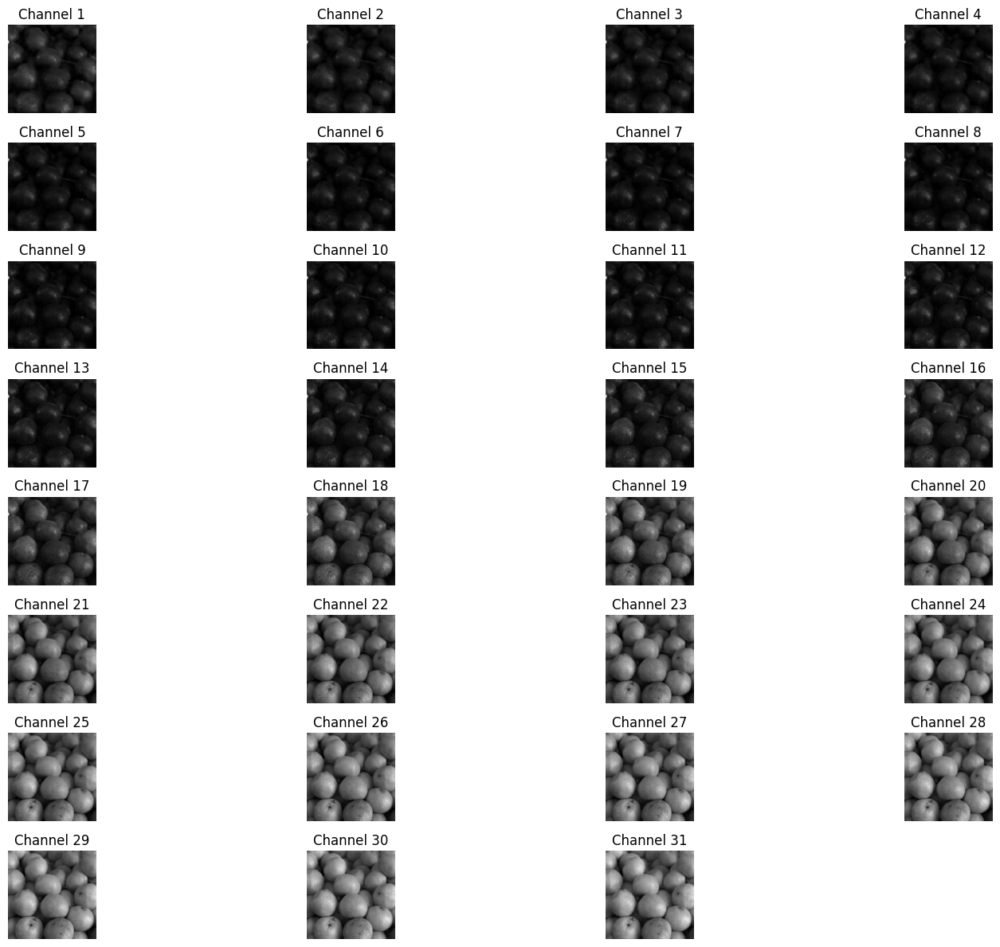

In [17]:
import matplotlib.pyplot as plt

# Assuming 'output' is the result from your model and has shape [1, 31, 482, 512]
# Remove the batch dimension if it exists
if len(output.shape) > 3:
    output = output.squeeze(0)

num_channels = output.shape[0]
num_rows = 8  # You can adjust this based on your preference
num_cols = (num_channels + num_rows - 1) // num_rows  # Calculate the number of columns

plt.figure(figsize=(16, 12))  # Adjust the figure size as needed

for i in range(num_channels):
    plt.subplot(num_rows, num_cols, i + 1)
    channel_data = output[i].cpu().numpy()  # Convert the channel data to a NumPy array
    plt.imshow(channel_data, cmap='gray')  # Display the image in grayscale
    plt.title(f'Channel {i + 1}')
    plt.axis('off')

plt.tight_layout()
plt.show()


## bigger visulaization

In [91]:
# import matplotlib.pyplot as plt

# # Assuming 'output' is the result from your model and has shape [1, 31, 482, 512]
# # Remove the batch dimension if it exists
# if len(output.shape) > 3:
#     output = output.squeeze(0)

# num_channels = output.shape[0]

# # Loop through each channel and create a separate figure
# for i in range(num_channels):
#     plt.figure(figsize=(8, 6))  # Adjust the figure size as needed
#     channel_data = output[i].cpu().numpy()  # Convert the channel data to a NumPy array
#     plt.imshow(channel_data, cmap='gray')  # Display the image in grayscale
#     plt.title(f'Channel {i + 1}')
#     plt.axis('off')
#     plt.show()


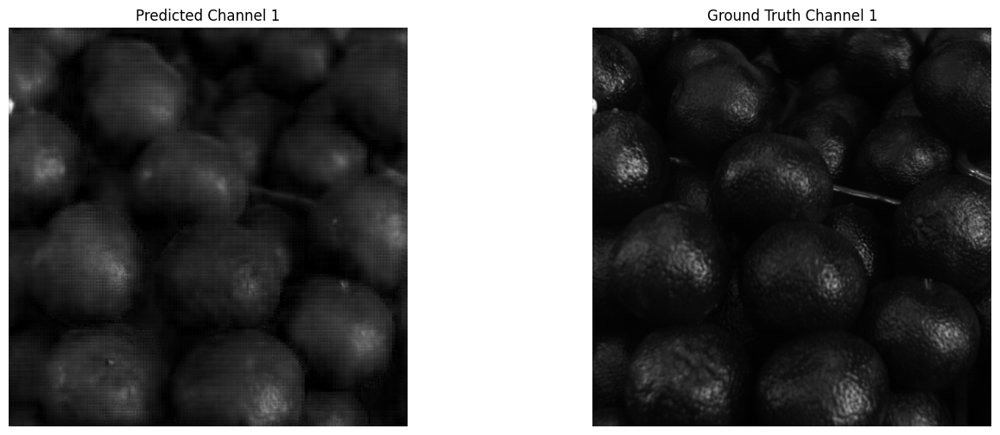

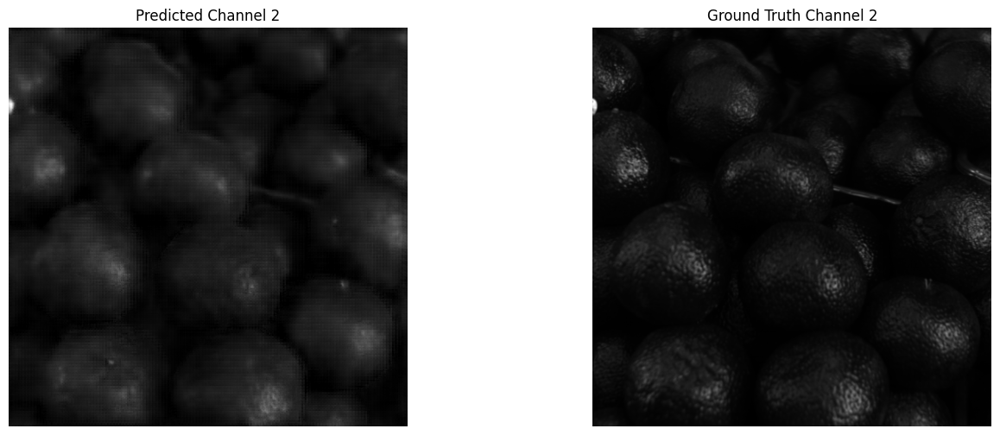

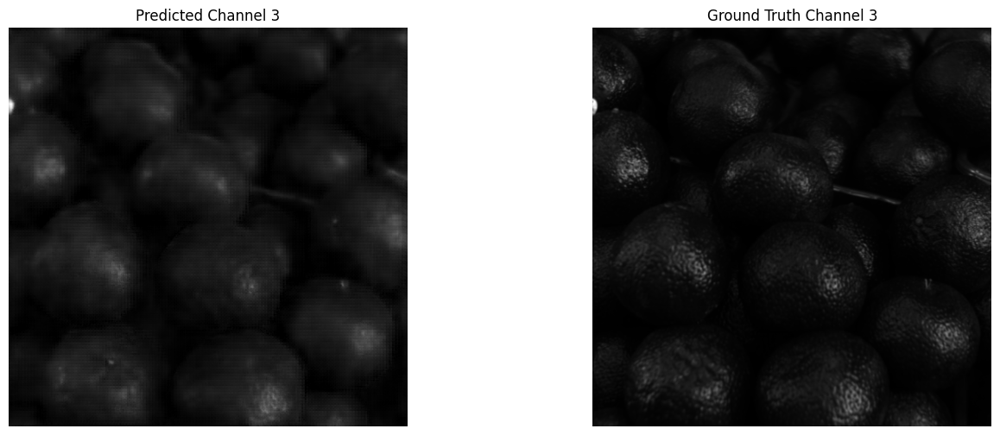

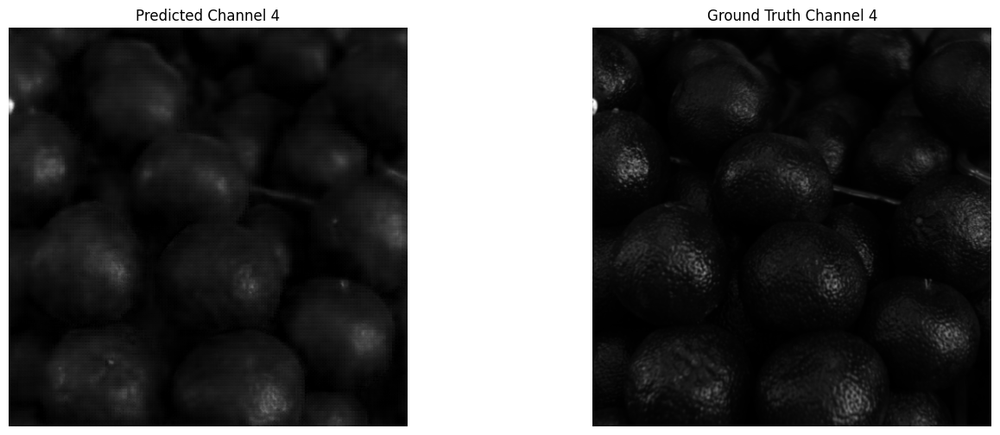

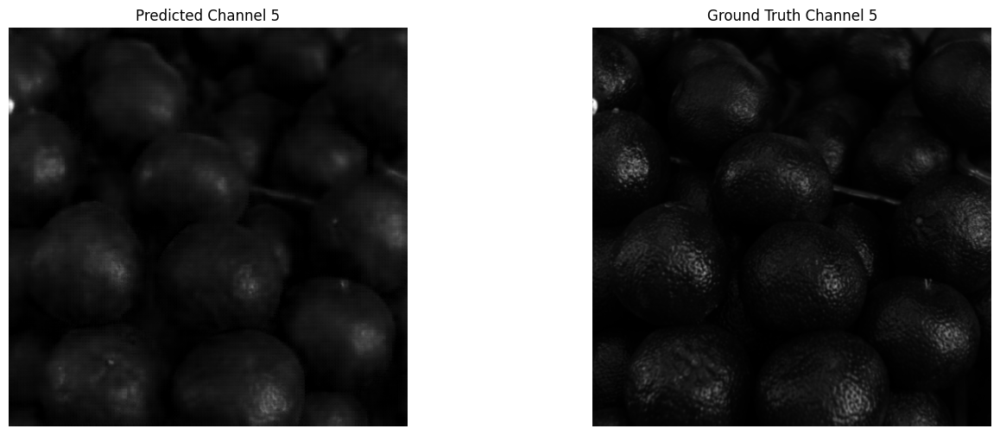

...

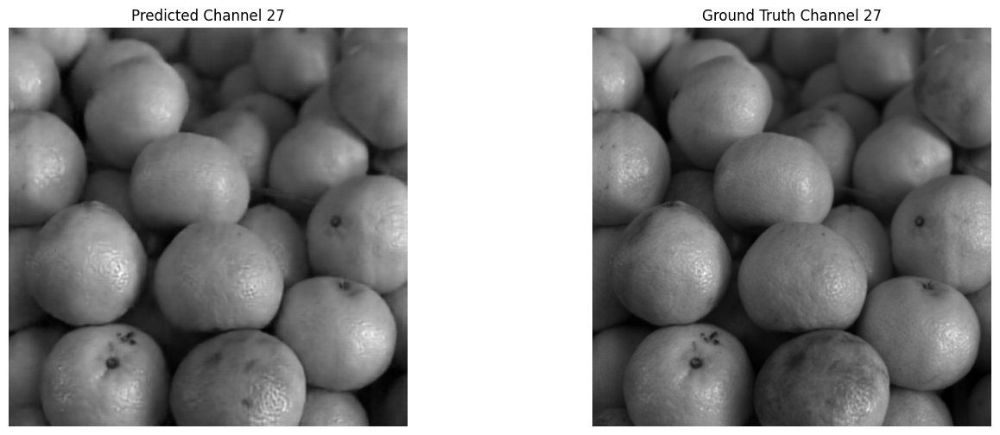

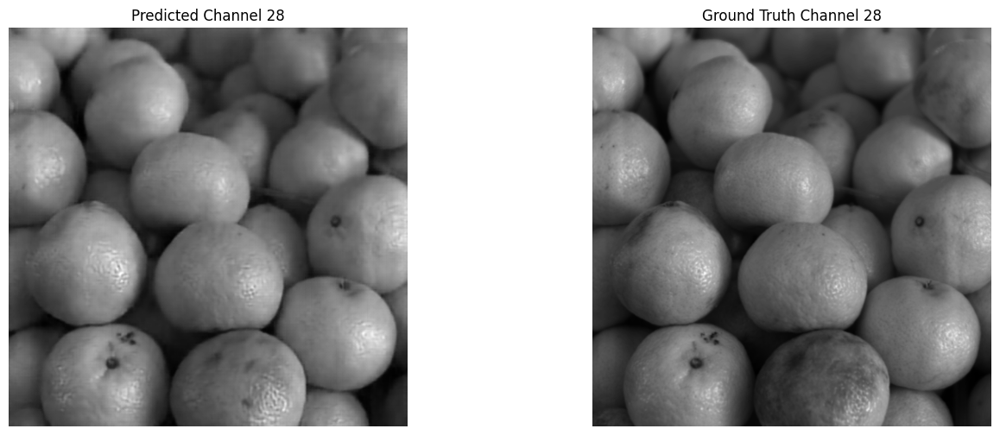

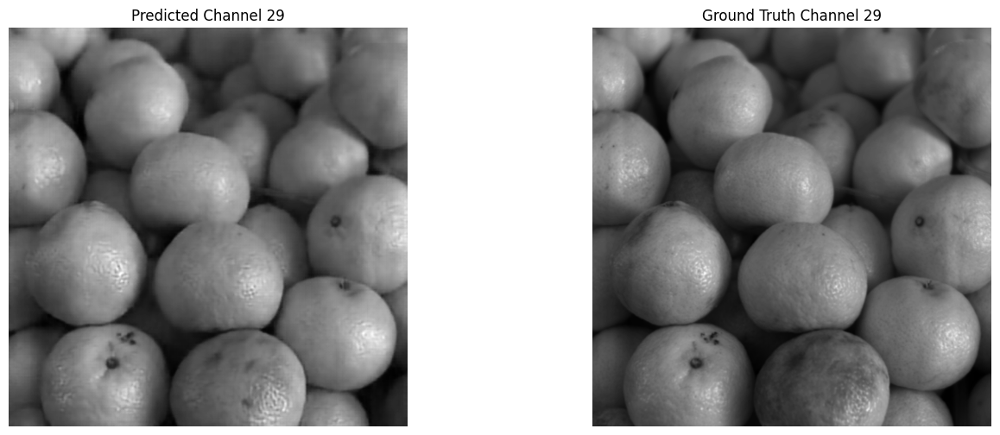

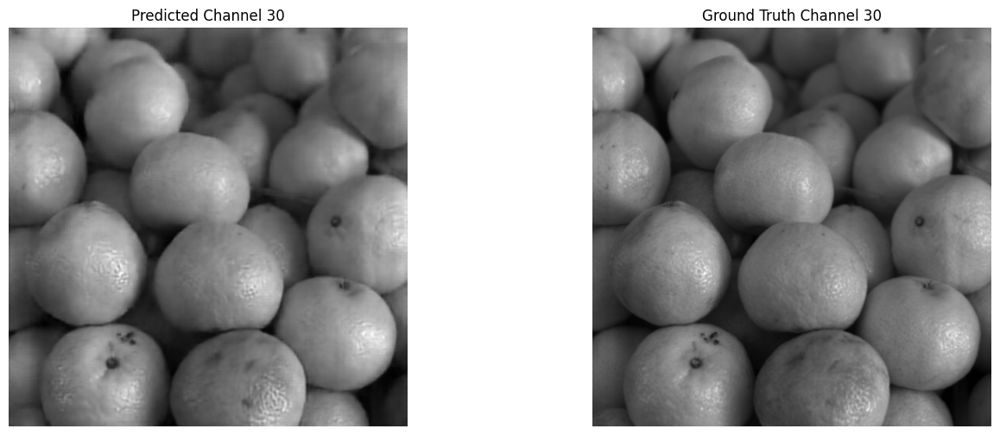

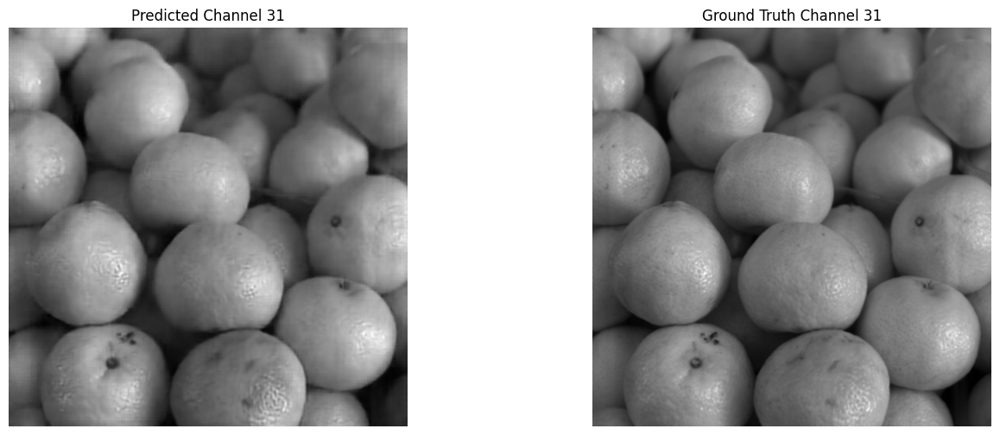

In [18]:
import matplotlib.pyplot as plt

# Assuming 'output' is the model's predicted output with shape [1, 31, 482, 512]
# And 'ground_truth' is the ground truth data with the same shape [1, 31, 482, 512]
# Sample code to get the data
sample = train_dataset[164]
# sample = valid_dataset[28]

x, ground_truth = sample[0], sample[1]

# Remove the batch dimension if it exists in the output tensor
if len(output.shape) > 3:
    output = output.squeeze(0)

num_channels = output.shape[0]

# Loop through each channel and create subplots for predicted and ground truth
for i in range(num_channels):
    plt.figure(figsize=(16, 6))  # Adjust the figure size as needed

    # Display predicted image
    plt.subplot(1, 2, 1)  # 1 row, 2 columns, first subplot
    channel_data_pred = output[i].cpu().numpy()  # Convert to NumPy array
    plt.imshow(channel_data_pred, cmap='gray')  # Display in grayscale
    plt.title(f'Predicted Channel {i + 1}')
    plt.axis('off')

    # Display ground truth image
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, second subplot
    channel_data_gt = ground_truth[i]  # Directly use the NumPy array
    plt.imshow(channel_data_gt, cmap='gray')  # Display in grayscale
    plt.title(f'Ground Truth Channel {i + 1}')
    plt.axis('off')

    plt.show()


In [19]:
# import torch
# import scipy.io
# import os
# import numpy as np
# import math

# def load_mat_to_tensor(file_path):
#     """ Load a .mat file and convert it to a torch tensor. """
#     mat = scipy.io.loadmat(file_path)
#     # Assuming the relevant data is stored under the key 'data'
#     array = mat['data']
#     tensor = torch.tensor(array, dtype=torch.float32)
#     return tensor

# def psnr_loss(outputs, targets, max_pixel=1.0):
#     mse = torch.mean((outputs - targets) ** 2)
#     if mse == 0:
#         return float('inf')
#     psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
#     return psnr

# def calculate_average_psnr(predicted_folder, ground_truth_folder):
#     total_psnr = 0.0
#     num_files = 0

#     for filename in os.listdir(predicted_folder):
#         predicted_file = os.path.join(predicted_folder, filename)
#         ground_truth_file = os.path.join(ground_truth_folder, filename)

#         if os.path.exists(ground_truth_file):
#             predicted_hsi = load_mat_to_tensor(predicted_file)
#             ground_truth_hsi = load_mat_to_tensor(ground_truth_file)

#             # Ensure shapes are compatible and compute PSNR
#             # Optionally, resize or reshape tensors if necessary
#             psnr_val = psnr_loss(predicted_hsi, ground_truth_hsi)

#             total_psnr += psnr_val
#             num_files += 1
#         else:
#             print(f"Ground truth file for {filename} not found.")

#     avg_psnr = total_psnr / num_files if num_files > 0 else 0
#     return avg_psnr

# # Paths to the folders
# predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/hdnet'
# ground_truth_folder = 'C:/Users/user/Desktop/Research/Datasets/Manual_split_NTIRE_2022/Valid_spectral'

# # Calculate average PSNR
# average_psnr = calculate_average_psnr(predicted_folder, ground_truth_folder)
# print(f"Average PSNR: {average_psnr:.4f}")


## full image evaluation

In [61]:
import torch
import h5py
import os
import numpy as np
import math

def load_mat_to_tensor_v73(file_path):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])
        tensor = torch.tensor(data, dtype=torch.float32)
        return tensor

def psnr_loss(outputs, targets, max_pixel=1.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

def calculate_average_psnr(predicted_folder, ground_truth_folder):
    total_psnr = 0.0
    num_files = 0

    for filename in os.listdir(predicted_folder):
        predicted_file = os.path.join(predicted_folder, filename)
        ground_truth_file = os.path.join(ground_truth_folder, filename)

        if os.path.exists(ground_truth_file):
            predicted_hsi = load_mat_to_tensor_v73(predicted_file)
            ground_truth_hsi = load_mat_to_tensor_v73(ground_truth_file)

            # Ensure shapes are compatible and compute PSNR
            psnr_val = psnr_loss(predicted_hsi, ground_truth_hsi)

            total_psnr += psnr_val
            num_files += 1
        else:
            print(f"Ground truth file for {filename} not found.")

    avg_psnr = total_psnr / num_files if num_files > 0 else 0
    return avg_psnr

# Paths to the folders
predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/mst_plus_plus'
# ground_truth_folder = 'C:/Users/user/Desktop/Research/Datasets/Manual_split_NTIRE_2022/Valid_spectral'
ground_truth_folder = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_spectral"
# Calculate average PSNR
average_psnr = calculate_average_psnr(predicted_folder, ground_truth_folder)
print(f"Average PSNR: {average_psnr:.4f}")


Average PSNR: 32.1270


## more evals

In [91]:
import torch
import h5py
import os
import numpy as np
import math
from skimage.metrics import structural_similarity as ssim

def load_mat_to_tensor_v73(file_path):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])
        tensor = torch.tensor(data, dtype=torch.float32)
        return tensor

def psnr_loss(outputs, targets, max_pixel=1.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * math.log10(max_pixel) - 10 * math.log10(mse)

def mrae(outputs, targets):
    epsilon = 1e-8  # Small value to prevent division by zero
    relative_error = torch.abs((outputs - targets) / (targets + epsilon))
    return torch.mean(relative_error)

def rmse(outputs, targets):
    return torch.sqrt(torch.mean((outputs - targets) ** 2))

def calculate_ssim(outputs, targets, data_range=1.0):
    outputs_np = outputs.numpy()
    targets_np = targets.numpy()
    return ssim(targets_np, outputs_np, data_range=data_range, multichannel=True)

def evaluate_metrics(predicted_folder, ground_truth_folder):
    total_psnr, total_ssim, total_mrae, total_rmse = 0.0, 0.0, 0.0, 0.0
    num_files = 0

    for filename in os.listdir(predicted_folder):
        predicted_file = os.path.join(predicted_folder, filename)
        ground_truth_file = os.path.join(ground_truth_folder, filename)

        if os.path.exists(ground_truth_file):
            predicted_hsi = load_mat_to_tensor_v73(predicted_file)
            ground_truth_hsi = load_mat_to_tensor_v73(ground_truth_file)

            # Evaluate metrics
            psnr_val = psnr_loss(predicted_hsi, ground_truth_hsi)
            ssim_val = calculate_ssim(predicted_hsi, ground_truth_hsi)
            mrae_val = mrae(predicted_hsi, ground_truth_hsi)
            rmse_val = rmse(predicted_hsi, ground_truth_hsi)

            total_psnr += psnr_val
            total_ssim += ssim_val
            total_mrae += mrae_val
            total_rmse += rmse_val
            num_files += 1
        else:
            print(f"Ground truth file for {filename} not found.")

    avg_psnr = total_psnr / num_files if num_files > 0 else 0
    avg_ssim = total_ssim / num_files if num_files > 0 else 0
    avg_mrae = total_mrae / num_files if num_files > 0 else 0
    avg_rmse = total_rmse / num_files if num_files > 0 else 0

    return avg_psnr, avg_ssim, avg_mrae, avg_rmse

# Paths to the folders
predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/awan/'
ground_truth_folder = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_spectral"

# Calculate average metrics
average_psnr, average_ssim, average_mrae, average_rmse = evaluate_metrics(predicted_folder, ground_truth_folder)
print(f"Average PSNR: {average_psnr:.4f}")
print(f"Average SSIM: {average_ssim:.4f}")
print(f"Average MRAE: {average_mrae:.4f}")
print(f"Average RMSE: {average_rmse:.4f}")


RuntimeError: The size of tensor a (246) must match the size of tensor b (482) at non-singleton dimension 2

In [52]:
import h5py
import torch

def load_mat_to_tensor_v73(file_path):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])  # Adjust the key if necessary
        tensor = torch.tensor(data, dtype=torch.float32)
        return tensor

# Path to the .mat file
# mat_file_path = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/hdnet/ARAD_1K_0901.mat'  # Replace with your .mat file path
mat_file_path = "C:/Users/user/Desktop/Research/Prediction/ARAD_1K_0901.mat"
# Load the .mat file and convert it to a tensor
tensor = load_mat_to_tensor_v73(mat_file_path)

# Print the shape of the tensor
print("Shape of the image:", tensor.shape)


Shape of the image: torch.Size([31, 512, 512])


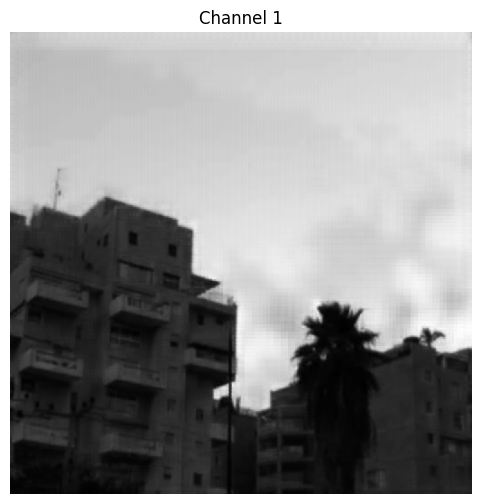

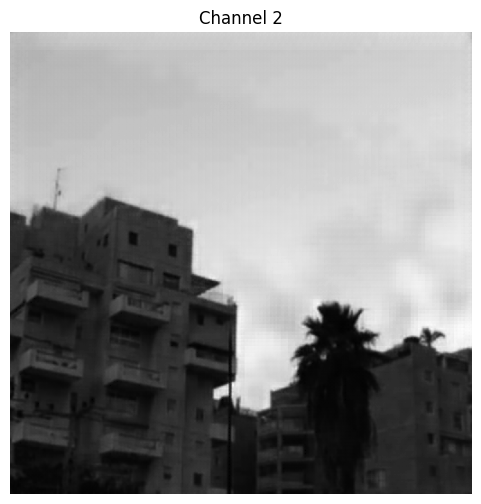

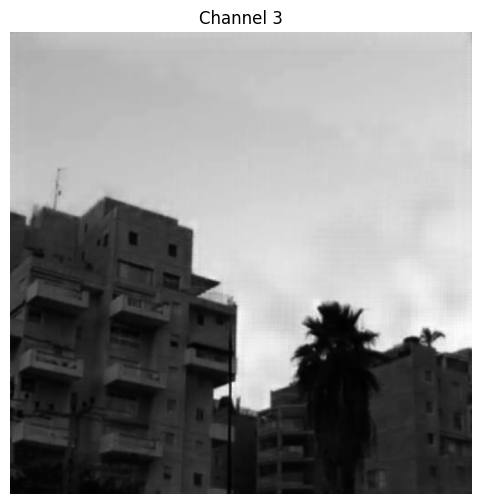

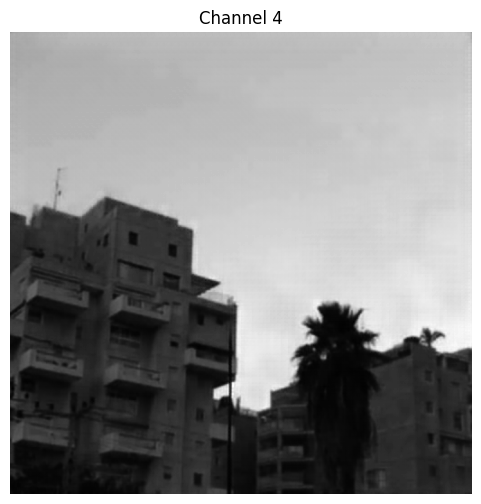

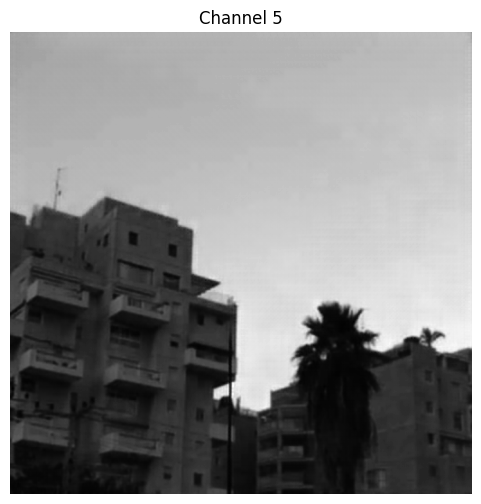

...

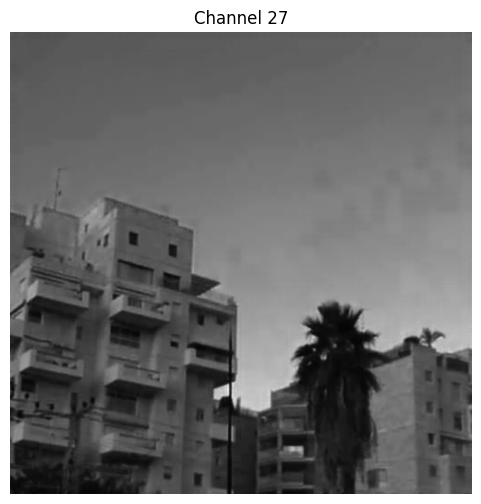

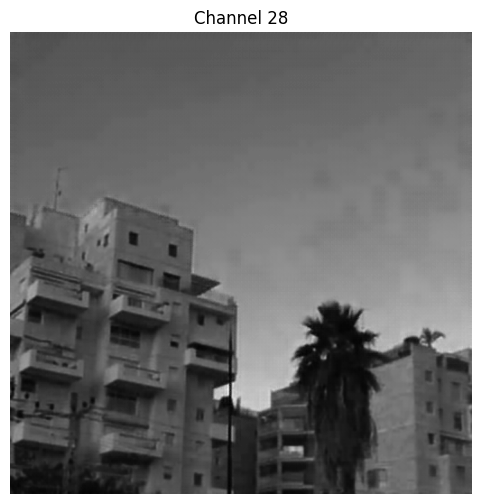

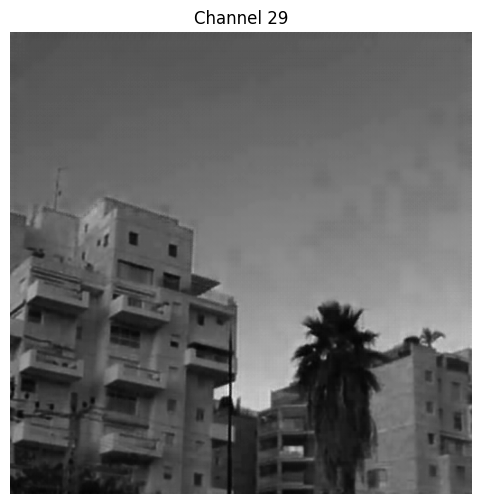

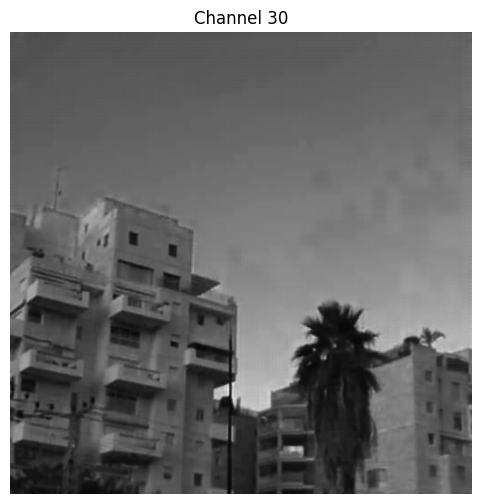

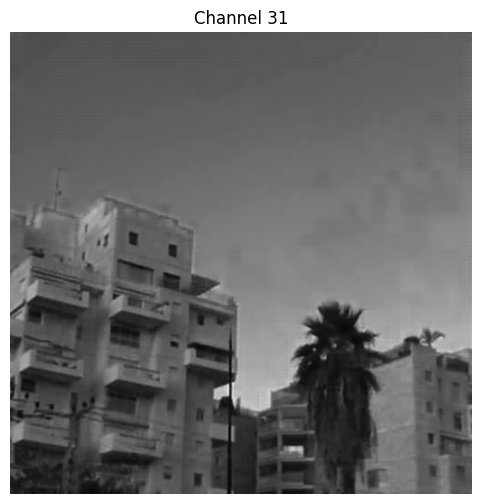

In [53]:
import matplotlib.pyplot as plt


# Iterate through each channel in the tensor
for i in range(tensor.shape[0]):
    plt.figure(figsize=(6, 6))  # Adjust the figure size as needed
    channel_data = tensor[i]  # Directly use the numpy array

    # Display the channel data
    plt.imshow(channel_data, cmap='gray')
    plt.title(f'Channel {i + 1}')
    plt.axis('off')
    
    # Show the plot for the current channel
    plt.show()


## middle 128 to -128 evalution

In [28]:
import torch
import h5py
import os
import numpy as np
import math

def load_mat_to_tensor_v73(file_path):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])
        tensor = torch.tensor(data, dtype=torch.float32)
        return tensor

def psnr_loss(outputs, targets, max_pixel=1.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

def calculate_average_psnr(predicted_folder, ground_truth_folder):
    total_psnr = 0.0
    num_files = 0

    for filename in os.listdir(predicted_folder):
        predicted_file = os.path.join(predicted_folder, filename)
        ground_truth_file = os.path.join(ground_truth_folder, filename)

        if os.path.exists(ground_truth_file):
            predicted_hsi = load_mat_to_tensor_v73(predicted_file)
            ground_truth_hsi = load_mat_to_tensor_v73(ground_truth_file)

            # Slice tensors to focus on the central region
            central_predicted_hsi = predicted_hsi[:, 128:-128, 128:-128]
            central_ground_truth_hsi = ground_truth_hsi[:, 128:-128, 128:-128]

            # Ensure shapes are compatible and compute PSNR for the central region
            psnr_val = psnr_loss(central_predicted_hsi, central_ground_truth_hsi)

            total_psnr += psnr_val
            num_files += 1
        else:
            print(f"Ground truth file for {filename} not found.")

    avg_psnr = total_psnr / num_files if num_files > 0 else 0
    return avg_psnr

# Paths to the folders
predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/mst_plus_plus'
# ground_truth_folder = 'C:/Users/user/Desktop/Research/Datasets/Manual_split_NTIRE_2022/Valid_spectral'
ground_truth_folder = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_spectral"

# Calculate average PSNR for the central region
average_psnr = calculate_average_psnr(predicted_folder, ground_truth_folder)
print(f"Average PSNR: {average_psnr:.4f}")


Average PSNR: 34.3162


## more evals

In [57]:
import torch
import h5py
import os
import numpy as np
import math
from skimage.metrics import structural_similarity as ssim

def load_mat_to_tensor_v73(file_path):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])
        tensor = torch.tensor(data, dtype=torch.float32)
        return tensor

def psnr_loss(outputs, targets, max_pixel=1.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    return 20 * math.log10(max_pixel) - 10 * math.log10(mse)

def mrae(outputs, targets):
    return torch.mean(torch.abs((outputs - targets) / targets))

def rmse(outputs, targets):
    return torch.sqrt(torch.mean((outputs - targets) ** 2))

def calculate_ssim(outputs, targets, data_range=1.0):
    outputs_np = outputs.numpy()
    targets_np = targets.numpy()
    return ssim(targets_np, outputs_np, data_range=data_range, multichannel=True)


def evaluate_metrics(predicted_folder, ground_truth_folder):
    total_psnr, total_ssim, total_mrae, total_rmse = 0.0, 0.0, 0.0, 0.0
    num_files = 0

    for filename in os.listdir(predicted_folder):
        predicted_file = os.path.join(predicted_folder, filename)
        ground_truth_file = os.path.join(ground_truth_folder, filename)

        if os.path.exists(ground_truth_file):
            predicted_hsi = load_mat_to_tensor_v73(predicted_file)
            ground_truth_hsi = load_mat_to_tensor_v73(ground_truth_file)

            # Slice tensors to focus on the central region
            central_predicted_hsi = predicted_hsi[:, 128:-128, 128:-128]
            central_ground_truth_hsi = ground_truth_hsi[:, 128:-128, 128:-128]

            # Evaluate metrics
            psnr_val = psnr_loss(central_predicted_hsi, central_ground_truth_hsi)
            ssim_val = calculate_ssim(central_predicted_hsi, central_ground_truth_hsi)
            mrae_val = mrae(central_predicted_hsi, central_ground_truth_hsi)
            rmse_val = rmse(central_predicted_hsi, central_ground_truth_hsi)

            total_psnr += psnr_val
            total_ssim += ssim_val
            total_mrae += mrae_val
            total_rmse += rmse_val
            num_files += 1
        else:
            print(f"Ground truth file for {filename} not found.")

    avg_psnr = total_psnr / num_files if num_files > 0 else 0
    avg_ssim = total_ssim / num_files if num_files > 0 else 0
    avg_mrae = total_mrae / num_files if num_files > 0 else 0
    avg_rmse = total_rmse / num_files if num_files > 0 else 0

    return avg_psnr, avg_ssim, avg_mrae, avg_rmse

predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/hinet/'
# ground_truth_folder = 'C:/Users/user/Desktop/Research/Datasets/Manual_split_NTIRE_2022/Valid_spectral'
ground_truth_folder = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_spectral"

# Calculate average metrics for the central region
average_psnr, average_ssim, average_mrae, average_rmse = evaluate_metrics(predicted_folder, ground_truth_folder)
print(f"Average PSNR: {average_psnr:.4f}")
print(f"Average SSIM: {average_ssim:.4f}")
print(f"Average MRAE: {average_mrae:.4f}")
print(f"Average RMSE: {average_rmse:.4f}")


Average PSNR: 32.5071
Average SSIM: 0.9311
Average MRAE: 0.2032
Average RMSE: 0.0303


## our model pred

In [12]:
# from Models_code.FocusNet_norm import FocusNet
# from Models_code.inverseUNet import UNet
from Models_code.HyperAttention_fft_norm_2 import HyperAttention
# from Models_code.Dwt_ntire import MWCNN
# from Models_code.FocusNet_mixedpool import FocusNet
# from Models_code.Simple_UNet import Simple_UNet
# from Models_code.MST_plus_plus import MST_Plus_Plus


#  model = MST(dim=31, stage=2, num_blocks=[4, 7, 5]).cuda()
model = HyperAttention(in_channels=3, out_channels=31).to(device).float()
# model = FocusNet(in_channels=3, out_channels=31).to(device).float()
# model = UNet(in_channels=3, out_channels=31).to(device).float()
# model = Simple_UNet(in_channels=3, out_channels=31).to(device).float()
# model = MWCNN().to(device).float()


model.load_state_dict(torch.load('../Models/HyperAttention_norm_2.0_freeze_700e.pth', map_location=device))
# model.load_state_dict(torch.load('../Hyper_Skin/Models/best_HyperAttention_fft_rgb.pth', map_location=device))
model.eval() 

HyperAttention(
  (enc1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (enc2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (en2_spatial_att): SpatialAttention(
    (conv1): Conv2d(128, 1, kernel_size=(1, 1), stride=(1, 1))
    (sigmoid): Sigmoid()
    (batch_norm): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (enc3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace

In [62]:
import torch
import h5py
import os
from PIL import Image
from torchvision.transforms import Compose, ToTensor, Resize
import cv2

def load_image_to_tensor(file_path):
    image = cv2.imread(file_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB
    image = cv2.resize(image, (512, 512))  # Resize to 512x512
    image = np.float32(image) / 255.0  # Normalize to [0, 1]
    tensor = ToTensor()(image)  # Convert to PyTorch tensor
    return tensor

def save_tensor_to_mat(tensor, file_path):
    with h5py.File(file_path, 'w') as f:
        # Assuming the tensor shape is [1, C, H, W]
        data = tensor.squeeze(0).numpy()  # Convert to [C, H, W]
        f.create_dataset('cube', data=data)

def predict_and_save(model, input_folder, output_folder, device):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    model.eval()
    with torch.no_grad():
        for filename in os.listdir(input_folder):
            if filename.lower().endswith(('.png', '.jpg', '.jpeg')):
                file_path = os.path.join(input_folder, filename)
                output_path = os.path.join(output_folder, os.path.splitext(filename)[0] + '.mat')
                
                input_tensor = load_image_to_tensor(file_path).to(device)
                
                # Predict
                predicted_output = model(input_tensor.unsqueeze(0))  # Add batch dimension
                print(input_tensor.shape,predicted_output.shape)

                # Save output in (C, H, W) format
                print('saving...')
                save_tensor_to_mat(predicted_output.cpu(), output_path)

# Paths
input_folder = 'C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_RGB'
output_folder = 'C:/Users/user/Desktop/Research/Prediction'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Assuming model is already loaded and moved to the correct device
model.to(device)

# Predict and save
predict_and_save(model, input_folder, output_folder, device)


torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size([3, 512, 512]) torch.Size([1, 31, 512, 512])
saving...
torch.Size

In [47]:
import os
import torch
import torchvision.transforms as transforms
from PIL import Image
import h5py
import numpy as np

from Models_code.HyperAttention_fft_norm_2 import HyperAttention

# Assuming you have already defined 'device' somewhere in your code
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = HyperAttention(in_channels=3, out_channels=31).to(device).float()
model.load_state_dict(torch.load('../Models/HyperAttention_norm_2.0_freeze_700e.pth', map_location=device))
model.eval()

input_folder = 'C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_RGB'
output_folder = 'C:/Users/user/Desktop/Research/Prediction'
os.makedirs(output_folder, exist_ok=True)

preprocess = transforms.Compose([
    transforms.Resize((512, 512)),
    transforms.ToTensor(),
])

for filename in os.listdir(input_folder):
    if filename.endswith(".jpg"):  # Change to .jpg for JPG images
        image_path = os.path.join(input_folder, filename)
        
        # Load the image and apply preprocessing
        image = Image.open(image_path).convert('RGB')  # Ensure it's in RGB format
        input_tensor = preprocess(image)

        # Add an extra dimension to match the batch size
        input_tensor = input_tensor.unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(input_tensor)

        # Processing for saving the output
        output_np = output.cpu().numpy()
        output_mat_file = os.path.join(output_folder, os.path.splitext(filename)[0] + ".mat")

        with h5py.File(output_mat_file, 'w') as mat_file:
            mat_file.create_dataset('cube', data=output_np[0])

        print(f"Processed {filename} and saved as {os.path.basename(output_mat_file)}")


Processed ARAD_1K_0901.jpg and saved as ARAD_1K_0901.mat
Processed ARAD_1K_0902.jpg and saved as ARAD_1K_0902.mat
Processed ARAD_1K_0903.jpg and saved as ARAD_1K_0903.mat
Processed ARAD_1K_0904.jpg and saved as ARAD_1K_0904.mat
Processed ARAD_1K_0905.jpg and saved as ARAD_1K_0905.mat
Processed ARAD_1K_0906.jpg and saved as ARAD_1K_0906.mat
Processed ARAD_1K_0907.jpg and saved as ARAD_1K_0907.mat
Processed ARAD_1K_0908.jpg and saved as ARAD_1K_0908.mat
Processed ARAD_1K_0909.jpg and saved as ARAD_1K_0909.mat
Processed ARAD_1K_0910.jpg and saved as ARAD_1K_0910.mat
Processed ARAD_1K_0911.jpg and saved as ARAD_1K_0911.mat
Processed ARAD_1K_0912.jpg and saved as ARAD_1K_0912.mat
Processed ARAD_1K_0913.jpg and saved as ARAD_1K_0913.mat
Processed ARAD_1K_0914.jpg and saved as ARAD_1K_0914.mat
Processed ARAD_1K_0915.jpg and saved as ARAD_1K_0915.mat
Processed ARAD_1K_0916.jpg and saved as ARAD_1K_0916.mat
Processed ARAD_1K_0917.jpg and saved as ARAD_1K_0917.mat
Processed ARAD_1K_0918.jpg and 

In [50]:
import torch
import h5py
import os
import numpy as np
import math
import cv2

def load_mat_to_tensor_v73(file_path, target_size=(512, 512)):
    """ Load a .mat v7.3 file and convert it to a torch tensor. """
    with h5py.File(file_path, 'r') as f:
        data = np.array(f['cube'])
        # Resize the data
        data_resized = cv2.resize(data.transpose(1, 2, 0), target_size).transpose(2, 1, 0)
        tensor = torch.tensor(data_resized, dtype=torch.float32)
        return tensor

def psnr_loss(outputs, targets, max_pixel=1.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

def calculate_average_psnr(predicted_folder, ground_truth_folder):
    total_psnr = 0.0
    num_files = 0

    for filename in os.listdir(predicted_folder):
        predicted_file = os.path.join(predicted_folder, filename)
        ground_truth_file = os.path.join(ground_truth_folder, filename)

        if os.path.exists(ground_truth_file):
            predicted_hsi = load_mat_to_tensor_v73(predicted_file)
            ground_truth_hsi = load_mat_to_tensor_v73(ground_truth_file)

            print(f"Predicted Shape: {predicted_hsi.shape}")
            print(f"Ground Truth Shape: {ground_truth_hsi.shape}")

            psnr_val = psnr_loss(predicted_hsi, ground_truth_hsi)
            print(psnr_val)
            total_psnr += psnr_val
            num_files += 1
        else:
            print(f"Ground truth file for {filename} not found.")

    avg_psnr = total_psnr / num_files if num_files > 0 else 0
    return avg_psnr

# Rest of the code remains the same


# Paths to the folders
# predicted_folder = 'C:/Users/user/Desktop/Research/original_MST-plus-plus/test_develop_code/exp/mst_plus_plus'
predicted_folder = "C:/Users/user/Desktop/Research/Prediction"
ground_truth_folder = "C:/Users/user/Desktop/Research/MST-plus-plus/dataset/Valid_spectral"

# Calculate average PSNR
average_psnr = calculate_average_psnr(predicted_folder, ground_truth_folder)
print(f"Average PSNR: {average_psnr:.4f}")


Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
9.369289675359102
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
14.497688983012775
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
13.348013381475262
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
13.144054499350252
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
15.061339824509153
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
19.862839578844998
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
14.94250235081559
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
13.217732837156294
Predicted Shape: torch.Size([31, 512, 512])
Ground Truth Shape: torch.Size([31, 512, 512])
16.29550172142515
Predicted Sha

## Evaluation

In [54]:
# from Models_code.FocusNet_norm import FocusNet
# from Models_code.inverseUNet import UNet
from Models_code.HyperAttention_fft_norm_2 import HyperAttention
# from Models_code.Dwt_ntire import MWCNN
# from Models_code.FocusNet_averagepool import FocusNet
# from Models_code.Simple_UNet import Simple_UNet
# from Models_code.MST_plus_plus import MST_Plus_Plus


#  model = MST(dim=31, stage=2, num_blocks=[4, 7, 5]).cuda()
model = HyperAttention(in_channels=3, out_channels=31).to(device).float()
# model = FocusNet(in_channels=3, out_channels=31).to(device).float()
# model = UNet(in_channels=3, out_channels=31).to(device).float()
# model = Simple_UNet(in_channels=3, out_channels=31).to(device).float()
# model = MWCNN().to(device).float()


model.load_state_dict(torch.load('../Models/HyperAttention_norm_2.0_freeze_700e.pth', map_location=device))
# model.load_state_dict(torch.load('../Hyper_Skin/Models/best_HyperAttention_fft_rgb.pth', map_location=device))
model.eval() 

HyperAttention(
  (enc1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (enc2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (en2_spatial_att): SpatialAttention(
    (conv1): Conv2d(128, 1, kernel_size=(1, 1), stride=(1, 1))
    (sigmoid): Sigmoid()
    (batch_norm): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (enc3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace

In [55]:
import torch
import math
from piq import ssim
import torch.nn.functional as F

class SAMLoss(nn.Module):
    def __init__(self, epsilon=1e-6):
        super(SAMLoss, self).__init__()
        self.epsilon = epsilon

    def forward(self, predicted_hsi, ground_truth_hsi):
        # Reshape tensors if necessary
        if predicted_hsi.dim() == 4:  # Flatten 4D tensors to 2D
            predicted_hsi = predicted_hsi.view(predicted_hsi.size(0), predicted_hsi.size(1), -1)
            ground_truth_hsi = ground_truth_hsi.view(ground_truth_hsi.size(0), ground_truth_hsi.size(1), -1)

        # Calculate dot product and magnitudes
        dot_product = torch.sum(predicted_hsi * ground_truth_hsi, dim=2)
        magnitude_pred = torch.norm(predicted_hsi, dim=2) + self.epsilon
        magnitude_gt = torch.norm(ground_truth_hsi, dim=2) + self.epsilon

        # Calculate cosine of spectral angle and ensure it's within [-1 + epsilon, 1 - epsilon]
        cosine_theta = torch.clamp(dot_product / (magnitude_pred * magnitude_gt), -1 + self.epsilon, 1 - self.epsilon)

        # Calculate spectral angle in radians
        spectral_angle = torch.acos(cosine_theta)

        return torch.mean(spectral_angle)

criterion = SAMLoss()

def mrae_loss(outputs, targets):
    epsilon = 1e-8  # To avoid division by zero
    relative_error = torch.abs((outputs - targets) / (targets + epsilon))
    mrae = torch.mean(relative_error)
    return mrae

def l1_loss(outputs, targets):
    return F.l1_loss(outputs, targets, reduction='mean')

# Define the RMSE Loss Function
def rmse_loss(outputs, targets):
    mse = torch.mean((outputs - targets) ** 2)
    rmse = torch.sqrt(mse)
    return rmse

# Define the PSNR Loss Function
def psnr_loss(outputs, targets, max_pixel=1.0):  # Assuming normalized data [0, 1]
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

# Assuming the model is already in evaluation mode and loaded
model.eval()

# Initialize variables to store total losses
total_sam_loss = 0.0
total_ssim = 0.0
total_rmse = 0.0
total_psnr = 0.0
total_l1_loss = 0.0  # Initialize total L1 Loss
total_mrae = 0.0

with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass
        outputs_val = model(x_val)

        # Ensure output size matches target size
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=y_val.shape[2:], mode='bilinear', align_corners=False)

        # Min-max normalization for outputs and targets
        outputs_val_norm = (outputs_val - outputs_val.min()) / (outputs_val.max() - outputs_val.min() + 1e-8)
        y_val_norm = (y_val - y_val.min()) / (y_val.max() - y_val.min() + 1e-8)
#         print(outputs_val_norm.min(), outputs_val_norm.max())

        # Calculate losses
        sam_loss = criterion(outputs_val_norm, y_val_norm)
        ssim_val = ssim(outputs_val_norm, y_val_norm, data_range=1.0)
        rmse_val = rmse_loss(outputs_val_norm, y_val_norm)
        psnr_val = psnr_loss(outputs_val_norm, y_val_norm)
        l1_val = l1_loss(outputs_val_norm, y_val_norm)  # Calculate L1 Loss
        mrae_val = mrae_loss(outputs_val_norm, y_val_norm)

        # Accumulate the total losses
        total_sam_loss += sam_loss.item()
        total_ssim += ssim_val.item()
        total_rmse += rmse_val.item()
        total_psnr += psnr_val
        total_l1_loss += l1_val.item()
        total_mrae += mrae_val.item()

# Calculate the average losses over all batches
avg_sam_loss = total_sam_loss / len(valid_loader)
avg_ssim = total_ssim / len(valid_loader)
avg_rmse = total_rmse / len(valid_loader)
avg_psnr = total_psnr / len(valid_loader)
avg_l1_loss = total_l1_loss / len(valid_loader) 
avg_mrae = total_mrae / len(valid_loader)

# Print the average losses

# Print the average losses along with the model's name
model_name = type(model).__name__
print(f"Model Name: {model_name}")
print(f"Average L1 Loss: {avg_l1_loss:.4f}")
print(f"Average SAM Loss: {avg_sam_loss:.4f}")
print(f"Average MRAE: {avg_mrae:.4f}")
print(f"Average SSIM: {avg_ssim:.4f}")
print(f"Average RMSE: {avg_rmse:.4f}")
print(f"Average PSNR: {avg_psnr:.4f}")

Model Name: HyperAttention
Average L1 Loss: 0.0212
Average SAM Loss: 0.0994
Average MRAE: 0.3747
Average SSIM: 0.9427
Average RMSE: 0.0335
Average PSNR: 31.4643


## specific channel evaluation

In [94]:
# Assuming the model is already in evaluation mode and loaded
model.eval()

# Initialize variables to store total losses
total_sam_loss = 0.0
total_ssim = 0.0
total_rmse = 0.0
total_psnr = 0.0
total_l1_loss = 0.0
total_mrae = 0.0

# Range of channels to evaluate on (5 to 30)
channel_start, channel_end = 5, 25

with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass
        outputs_val = model(x_val)

        # Ensure output size matches target size
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=y_val.shape[2:], mode='bilinear', align_corners=False)

        # Select specific range of channels
        outputs_val_selected = outputs_val[:, channel_start:channel_end]
        y_val_selected = y_val[:, channel_start:channel_end]

        # Min-max normalization for outputs and targets
        outputs_val_norm = (outputs_val_selected - outputs_val_selected.min()) / (outputs_val_selected.max() - outputs_val_selected.min() + 1e-8)
        y_val_norm = (y_val_selected - y_val_selected.min()) / (y_val_selected.max() - y_val_selected.min() + 1e-8)

        # Calculate losses for the selected channels
        sam_loss = criterion(outputs_val_norm, y_val_norm)
        ssim_val = ssim(outputs_val_norm, y_val_norm, data_range=1.0)
        rmse_val = rmse_loss(outputs_val_norm, y_val_norm)
        psnr_val = psnr_loss(outputs_val_norm, y_val_norm)
        l1_val = l1_loss(outputs_val_norm, y_val_norm)
        mrae_val = mrae_loss(outputs_val_norm, y_val_norm)

        # Accumulate the total losses
        total_sam_loss += sam_loss.item()
        total_ssim += ssim_val.item()
        total_rmse += rmse_val.item()
        total_psnr += psnr_val
        total_l1_loss += l1_val.item()
        total_mrae += mrae_val.item()

# Calculate the average losses over all batches
avg_sam_loss = total_sam_loss / len(valid_loader)
avg_ssim = total_ssim / len(valid_loader)
avg_rmse = total_rmse / len(valid_loader)
avg_psnr = total_psnr / len(valid_loader)
avg_l1_loss = total_l1_loss / len(valid_loader) 
avg_mrae = total_mrae / len(valid_loader)

# Print the average losses
model_name = type(model).__name__
print(f"Model Name: {model_name}")
print(f"Average L1 Loss (Channels 5-30): {avg_l1_loss:.4f}")
print(f"Average SAM Loss (Channels 5-30): {avg_sam_loss:.4f}")
print(f"Average MRAE (Channels 5-30): {avg_mrae:.4f}")
print(f"Average SSIM (Channels 5-30): {avg_ssim:.4f}")
print(f"Average RMSE (Channels 5-30): {avg_rmse:.4f}")
print(f"Average PSNR (Channels 5-30): {avg_psnr:.4f}")


Model Name: HyperAttention
Average L1 Loss (Channels 5-30): 0.0167
Average SAM Loss (Channels 5-30): 0.0812
Average MRAE (Channels 5-30): 0.3349
Average SSIM (Channels 5-30): 0.9617
Average RMSE (Channels 5-30): 0.0272
Average PSNR (Channels 5-30): 33.2055


## patch evaluation 128:-128

In [56]:
import torch
import math
from piq import ssim
import torch.nn.functional as F

class SAMLoss(nn.Module):
    def __init__(self, epsilon=1e-6):
        super(SAMLoss, self).__init__()
        self.epsilon = epsilon

    def forward(self, predicted_hsi, ground_truth_hsi):
        # Reshape tensors if necessary
        if predicted_hsi.dim() == 4:  # Flatten 4D tensors to 2D
            predicted_hsi = predicted_hsi.view(predicted_hsi.size(0), predicted_hsi.size(1), -1)
            ground_truth_hsi = ground_truth_hsi.view(ground_truth_hsi.size(0), ground_truth_hsi.size(1), -1)

        # Calculate dot product and magnitudes
        dot_product = torch.sum(predicted_hsi * ground_truth_hsi, dim=2)
        magnitude_pred = torch.norm(predicted_hsi, dim=2) + self.epsilon
        magnitude_gt = torch.norm(ground_truth_hsi, dim=2) + self.epsilon

        # Calculate cosine of spectral angle and ensure it's within [-1 + epsilon, 1 - epsilon]
        cosine_theta = torch.clamp(dot_product / (magnitude_pred * magnitude_gt), -1 + self.epsilon, 1 - self.epsilon)

        # Calculate spectral angle in radians
        spectral_angle = torch.acos(cosine_theta)

        return torch.mean(spectral_angle)

criterion = SAMLoss()

def mrae_loss(outputs, targets):
    epsilon = 1e-8  # To avoid division by zero
    relative_error = torch.abs((outputs - targets) / (targets + epsilon))
    mrae = torch.mean(relative_error)
    return mrae

def l1_loss(outputs, targets):
    return F.l1_loss(outputs, targets, reduction='mean')

# Define the RMSE Loss Function
def rmse_loss(outputs, targets):
    mse = torch.mean((outputs - targets) ** 2)
    rmse = torch.sqrt(mse)
    return rmse

# Define the PSNR Loss Function
def psnr_loss(outputs, targets, max_pixel=1.0):  # Assuming normalized data [0, 1]
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

# Assuming the model is already in evaluation mode and loaded
model.eval()

# Initialize variables to store total losses
total_sam_loss = 0.0
total_ssim = 0.0
total_rmse = 0.0
total_psnr = 0.0
total_l1_loss = 0.0  # Initialize total L1 Loss
total_mrae = 0.0

with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass
        outputs_val = model(x_val)

        # Ensure output size matches target size
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=y_val.shape[2:], mode='bilinear', align_corners=False)

        # Focus on the central region (slicing from 128 to -128)
        central_outputs_val = outputs_val[:, :, 128:-128, 128:-128]
        central_y_val = y_val[:, :, 128:-128, 128:-128]

        # Min-max normalization for central outputs and targets
        central_outputs_val_norm = (central_outputs_val - central_outputs_val.min()) / (central_outputs_val.max() - central_outputs_val.min() + 1e-8)
        central_y_val_norm = (central_y_val - central_y_val.min()) / (central_y_val.max() - central_y_val.min() + 1e-8)

        # Calculate losses for the central region
        sam_loss = criterion(central_outputs_val_norm, central_y_val_norm)
        ssim_val = ssim(central_outputs_val_norm, central_y_val_norm, data_range=1.0)
        rmse_val = rmse_loss(central_outputs_val_norm, central_y_val_norm)
        psnr_val = psnr_loss(central_outputs_val_norm, central_y_val_norm)
        l1_val = l1_loss(central_outputs_val_norm, central_y_val_norm)
        mrae_val = mrae_loss(central_outputs_val_norm, central_y_val_norm)

        # Accumulate the total losses
        total_sam_loss += sam_loss.item()
        total_ssim += ssim_val.item()
        total_rmse += rmse_val.item()
        total_psnr += psnr_val
        total_l1_loss += l1_val.item()
        total_mrae += mrae_val.item()

# Calculate the average losses over all batches
avg_sam_loss = total_sam_loss / len(valid_loader)
avg_ssim = total_ssim / len(valid_loader)
avg_rmse = total_rmse / len(valid_loader)
avg_psnr = total_psnr / len(valid_loader)
avg_l1_loss = total_l1_loss / len(valid_loader) 
avg_mrae = total_mrae / len(valid_loader)

# Print the average losses

# Print the average losses along with the model's name
model_name = type(model).__name__
print(f"Model Name: {model_name}")
print(f"Average L1 Loss: {avg_l1_loss:.4f}")
print(f"Average SAM Loss: {avg_sam_loss:.4f}")
print(f"Average MRAE: {avg_mrae:.4f}")
print(f"Average SSIM: {avg_ssim:.4f}")
print(f"Average RMSE: {avg_rmse:.4f}")
print(f"Average PSNR: {avg_psnr:.4f}")

Model Name: HyperAttention
Average L1 Loss: 0.0238
Average SAM Loss: 0.1079
Average MRAE: 1.0291
Average SSIM: 0.9138
Average RMSE: 0.0344
Average PSNR: 30.5346


## train evals calculation

In [95]:
# Assuming the model is already in evaluation mode and loaded
model.eval()

# Initialize variables to store total losses for training dataset
total_sam_loss_train = 0.0
total_ssim_train = 0.0
total_rmse_train = 0.0
total_psnr_train = 0.0
total_l1_loss_train = 0.0
total_mrae_train = 0.0

with torch.no_grad():
    for batch_idx, (x_train, y_train) in enumerate(train_loader):
        x_train, y_train = x_train.to(device).float(), y_train.to(device).float()

        # Forward pass
        outputs_train = model(x_train)

        # Ensure output size matches target size
        outputs_train = torch.nn.functional.interpolate(outputs_train, size=y_train.shape[2:], mode='bilinear', align_corners=False)

        # Min-max normalization for outputs and targets
        outputs_train_norm = (outputs_train - outputs_train.min()) / (outputs_train.max() - outputs_train.min() + 1e-8)
        y_train_norm = (y_train - y_train.min()) / (y_train.max() - y_train.min() + 1e-8)

        # Calculate losses
        sam_loss_train = criterion(outputs_train_norm, y_train_norm)
        ssim_train = ssim(outputs_train_norm, y_train_norm, data_range=1.0)
        rmse_train = rmse_loss(outputs_train_norm, y_train_norm)
        psnr_train = psnr_loss(outputs_train_norm, y_train_norm)
        l1_train = l1_loss(outputs_train_norm, y_train_norm)
        mrae_train = mrae_loss(outputs_train_norm, y_train_norm)

        # Accumulate the total losses
        total_sam_loss_train += sam_loss_train.item()
        total_ssim_train += ssim_train.item()
        total_rmse_train += rmse_train.item()
        total_psnr_train += psnr_train
        total_l1_loss_train += l1_train.item()
        total_mrae_train += mrae_train.item()

# Calculate the average losses over all training batches
avg_sam_loss_train = total_sam_loss_train / len(train_loader)
avg_ssim_train = total_ssim_train / len(train_loader)
avg_rmse_train = total_rmse_train / len(train_loader)
avg_psnr_train = total_psnr_train / len(train_loader)
avg_l1_loss_train = total_l1_loss_train / len(train_loader)
avg_mrae_train = total_mrae_train / len(train_loader)

# Print the average losses for training dataset
print(f"Training Average L1 Loss: {avg_l1_loss_train:.4f}")
print(f"Training Average SAM Loss: {avg_sam_loss_train:.4f}")
print(f"Training Average MRAE: {avg_mrae_train:.4f}")
print(f"Training Average SSIM: {avg_ssim_train:.4f}")
print(f"Training Average RMSE: {avg_rmse_train:.4f}")
print(f"Training Average PSNR: {avg_psnr_train:.4f}")


Training Average L1 Loss: 0.0192
Training Average SAM Loss: 0.0900
Training Average MRAE: 0.3933
Training Average SSIM: 0.9466
Training Average RMSE: 0.0275
Training Average PSNR: 33.0697


## val sam

In [47]:
# Assuming model is already loaded and in evaluation mode
model.eval()
criterion = SAMLoss()

# Define a variable to store the total loss
total_val_loss = 0.0

# Iterate over the validation loader
with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass
        outputs_val = model(x_val)
        
        # You may need to apply the same interpolation to outputs_val as in the training loop
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=(512, 512), mode='bilinear', align_corners=False)

        # Calculate the loss
        val_loss = criterion(outputs_val, y_val)

        # Accumulate the total loss
        total_val_loss += val_loss.item()

# Calculate the average validation loss
avg_val_loss = total_val_loss / len(valid_loader)

# Print or use the average validation loss as needed
print(f"Average Validation Loss: {avg_val_loss:.4f}")


Average Validation Loss: 0.1035


## rmse

In [ ]:
import torch

# Define the RMSE Loss Function
def rmse_loss(outputs, targets):
    mse = torch.mean((outputs - targets) ** 2)
    rmse = torch.sqrt(mse)
    return rmse

# Function for min-max normalization
def min_max_normalize(tensor):
    min_val = tensor.min()
    max_val = tensor.max()
    normalized = (tensor - min_val) / (max_val - min_val)
    return normalized

# Assuming the model is already in evaluation mode and loaded
model.eval()

# Variable to store the total RMSE
total_rmse = 0.0
with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()
#         print('x_val max',x_val.max())

        # Forward pass
        outputs_val = model(x_val)

        # Resize outputs
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=(512, 512), mode='bilinear', align_corners=False)

        # Normalize the outputs
        outputs_val = min_max_normalize(outputs_val)

        # Check shapes and a few sample values
#         print(f"Batch: {batch_idx}")
#         print(f"Outputs Shape: {outputs_val.shape}, Targets Shape: {y_val.shape}")
#         print(f"Sample Outputs: {outputs_val[0, 0, :5, :5]}")
#         print(f"Sample Targets: {y_val[0, 0, :5, :5]}")

        # Calculate RMSE
        batch_rmse = rmse_loss(outputs_val, y_val)
        total_rmse += batch_rmse.item()
#         print(f"Batch RMSE: {batch_rmse.item()}\n")

# Calculate average RMSE
avg_rmse = total_rmse / len(valid_loader)
print(f"Average RMSE: {avg_rmse}")


## psnr

In [ ]:
import torch
import math

def psnr_loss(outputs, targets, max_pixel=255.0):
    mse = torch.mean((outputs - targets) ** 2)
    if mse == 0:
        return float('inf')
    psnr = 20 * math.log10(max_pixel) - 10 * math.log10(mse)
    return psnr

model.eval()
total_psnr = 0.0

with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()
#         print(y_val.max(), y_val.min())
        
        outputs_val = model(x_val)
#         print('output',outputs_val.max(), outputs_val.min())
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=y_val.shape[2:], mode='bilinear', align_corners=False)

        # Adjust max_pixel if your images are normalized or in a different scale
        max_pixel_val = 1.0 if y_val.max() <= 1.0 else 255.0
        batch_psnr = psnr_loss(outputs_val, y_val, max_pixel=max_pixel_val)
        total_psnr += batch_psnr

avg_psnr = total_psnr / len(valid_loader)
print(f"Average PSNR on Validation Set: {avg_psnr:.4f}")


## ssim

In [99]:
import torch
from piq import ssim

# Assuming the model is already in evaluation mode and loaded
model.eval()

# Variable to store the total SSIM
total_ssim = 0.0

with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass to get the outputs
        outputs_val = model(x_val)

        # Resize the outputs to match the target dimensions if necessary
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=(512, 512), mode='bilinear', align_corners=False)

        # Clip the outputs and targets to be in the range [0, 1]
        outputs_val = torch.clamp(outputs_val, 0, 1)
        y_val = torch.clamp(y_val, 0, 1)

        # Calculate SSIM for the current batch
        batch_ssim = ssim(outputs_val, y_val, data_range=1.0)

        # Accumulate total SSIM
        total_ssim += batch_ssim.item()

# Calculate the average SSIM over all batches
avg_ssim = total_ssim / len(valid_loader)

# Print or use the average SSIM as needed
print(f"Average SSIM on Validation Set: {avg_ssim:.4f}")


Average SSIM on Validation Set: 0.1616


In [100]:
import torch

# Define the MRAE Loss Function
def mrae_loss(outputs, targets):
    # Avoid division by zero
    targets = torch.where(targets == 0, torch.full_like(targets, 1e-8), targets)
    mrae = torch.mean(torch.abs((outputs - targets) / targets))
    return mrae

# Assuming the model is already in evaluation mode and loaded
model.eval()

# Variable to store the total MRAE
total_mrae = 0.0
with torch.no_grad():
    for batch_idx, (x_val, y_val) in enumerate(valid_loader):
        x_val, y_val = x_val.to(device).float(), y_val.to(device).float()

        # Forward pass
        outputs_val = model(x_val)

        # Resize outputs if necessary
        outputs_val = torch.nn.functional.interpolate(outputs_val, size=(512, 512), mode='bilinear', align_corners=False)

        # Calculate MRAE
        batch_mrae = mrae_loss(outputs_val, y_val)
        total_mrae += batch_mrae.item()

# Calculate average MRAE
avg_mrae = total_mrae / len(valid_loader)
print(f"Average MRAE: {avg_mrae:.4f}")


Average MRAE: 8034.3213


## train sam loss

In [58]:
# Assuming model is already loaded and in evaluation mode
model.eval()
criterion = SAMLoss()
# Define a variable to store the total loss
total_train_loss = 0.0

# Iterate over the training loader
with torch.no_grad():
    for batch_idx, (x_train, y_train) in enumerate(train_loader):  # Use train_loader instead of val_loader
        x_train, y_train = x_train.to(device).float(), y_train.to(device).float()

        # Forward pass
        outputs_train = model(x_train)
        
        # You may need to apply the same interpolation to outputs_train as in the training loop
        outputs_train = torch.nn.functional.interpolate(outputs_train,size=(512, 512), mode='bilinear', align_corners=False)

        # Calculate the loss
        train_loss = criterion(outputs_train, y_train)

        # Accumulate the total loss
        total_train_loss += train_loss.item()

# Calculate the average training loss
avg_train_loss = total_train_loss / len(train_loader)

# Print or use the average training loss as needed
print(f"Average Training Loss: {avg_train_loss:.4f}")


Average Training Loss: 0.0859


## train evals

In [59]:
# Assuming the model is in evaluation mode and loaded
model.eval()

# Initialize variables to store total losses for training data
total_sam_loss_train = 0.0
total_ssim_train = 0.0
total_rmse_train = 0.0
total_psnr_train = 0.0

with torch.no_grad():
    for batch_idx, (x_train, y_train) in enumerate(train_loader):
        x_train, y_train = x_train.to(device).float(), y_train.to(device).float()

        # Forward pass
        outputs_train = model(x_train)

        # Ensure output size matches target size
        outputs_train = torch.nn.functional.interpolate(outputs_train, size=y_train.shape[2:], mode='bilinear', align_corners=False)

        # Min-max normalization for outputs and targets
        outputs_train_norm = (outputs_train - outputs_train.min()) / (outputs_train.max() - outputs_train.min() + 1e-8)
        y_train_norm = (y_train - y_train.min()) / (y_train.max() - y_train.min() + 1e-8)

        # Calculate losses
        sam_loss_train = criterion(outputs_train_norm, y_train_norm)
        ssim_train = ssim(outputs_train_norm, y_train_norm, data_range=1.0)
        rmse_train = rmse_loss(outputs_train_norm, y_train_norm)
        psnr_train = psnr_loss(outputs_train_norm, y_train_norm)

        # Accumulate the total losses for training data
        total_sam_loss_train += sam_loss_train.item()
        total_ssim_train += ssim_train.item()
        total_rmse_train += rmse_train.item()
        total_psnr_train += psnr_train

# Calculate the average losses over all training batches
avg_sam_loss_train = total_sam_loss_train / len(train_loader)
avg_ssim_train = total_ssim_train / len(train_loader)
avg_rmse_train = total_rmse_train / len(train_loader)
avg_psnr_train = total_psnr_train / len(train_loader)

# Print the average losses for training data
print(f"Average SAM Loss on Training Data: {avg_sam_loss_train:.4f}")
print(f"Average SSIM on Training Data: {avg_ssim_train:.4f}")
print(f"Average RMSE on Training Data: {avg_rmse_train:.4f}")
print(f"Average PSNR on Training Data: {avg_psnr_train:.4f}")


Average SAM Loss on Training Data: 0.1348
Average SSIM on Training Data: 0.8732
Average RMSE on Training Data: 0.0310
Average PSNR on Training Data: 79.7411
